In [1]:
import sys
sys.version

'3.7.11 (default, Jan 28 2022, 19:13:48) \n[GCC 9.3.0]'

In [2]:
import fil_finder
from fil_finder import FilFinder2D, Filament2D
from astropy.io import fits

import copy

In [3]:
%matplotlib inline
import matplotlib.pyplot as plt
import astropy.units as u

# Optional settings for the plots. Comment out if needed.
# import seaborn as sb
# sb.set_context('poster')

import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12., 9.6)

In [4]:
import healpy as hp

In [5]:
def v2ch(v, w): # v(km/s)をchに変える
    x_tempo, y_tempo, v_tempo   = w.wcs_pix2world(0, 0, 0, 0)
    x_ch, y_ch, v_ch   = w.wcs_world2pix(x_tempo, y_tempo, v*1000.0, 0)
    v_ch = int(round(float(v_ch), 0))
    return v_ch

def del_header_key(header, keys): # headerのkeyを消す
    import copy
    h = copy.deepcopy(header)
    for k in keys:
        try:
            del h[k]
        except:
            pass
    return h
def make_new_hdu_integ(hdu, v_start_wcs, v_end_wcs, w): # 積分強度のhduを作る
    data = hdu.data
    header = hdu.header
    start_ch, end_ch = v2ch(v_start_wcs, w), v2ch(v_end_wcs, w)
    new_data = np.nansum(data[start_ch:end_ch+1], axis=0)*np.abs(header["CDELT3"])/1000.0
    header = del_header_key(header, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    header["NAXIS"] = 2
#     header["CTYPE1"] = "GLON-CAR"
#     header["CTYPE2"] = "GLAT-CAR"
    new_data[new_data==0.0]=np.nan
    try:
        header["WCSAXES"] = 2
    except:
        pass
    new_hdu = fits.PrimaryHDU(new_data, header)
    return new_hdu

In [6]:
from astropy.wcs import WCS
import numpy as np
from spectral_cube import Projection
import astropy
import aplpy

In [7]:
hdu = fits.open("/home/filament/Desktop/fil-test/fil_finder_fits/test_2.fits")[0]
w = WCS("/home/filament/Desktop/fil-test/test_2.fits")

#arr = np.nanmax(hdu.data[:, :256, :256], axis=0).astype(">f4")
arr = hdu.data[468, :256, :256].astype(">f4")

/home/filament/Desktop/fil-test/test_2.fits                                      [astropy.io.fits.card]


In [8]:
print(hdu.data.shape,arr.shape)

(933, 1071, 1595) (256, 256)


In [9]:
hdu.header

SIMPLE  =                    T                                                  
BITPIX  =                  -64                                                  
NAXIS   =                    3                                                  
NAXIS1  =                 1595                                                  
NAXIS2  =                 1071                                                  
NAXIS3  =                  933                                                  
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
CTYPE1  = 'GLON-AIT'                                                            
CTYPE2  = 'GLAT-AIT'                                                            
CRVAL1  =          0.000000000                                                  
CRVAL2  =          0.0000000

In [10]:
hdu.header["CUNIT1"] = "deg"
hdu.header["CUNIT2"] = "deg"
hdu.header["BPA"] = 0.0
hdu.header["BMAJ"] = 0.2706
hdu.header["BMIN"] = 0.2706
hdu.header["LONPOLE"] = 0.0
hdu.header["LATPOLE"] = 90.0

In [11]:
integ_hdu = make_new_hdu_integ(hdu, -50.0, -20.0, w)

TypeError: WCS projection has 2 dimensions, so expected 2 (an Nx2 array and the origin argument) or 3 arguments (the position in each dimension, and the origin argument). Instead, 4 arguments were given.

In [12]:
fil_cube = np.zeros_like(hdu.data)

In [13]:
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


NameError: name 'integ_hdu' is not defined

In [ ]:
def make_filament_array(hdu,i):
  fil = FilFinder2D(fits.PrimaryHDU(hdu.data[i], hdr1), distance=20 * u.pc, beamwidth=hdr1["BMAJ"]* u.deg)
  
  fil.preprocess_image(flatten_percent=95)
  fil.create_mask(verbose=True)
  fil.medskel(verbose=True)
  fil_skeleton= fil.skeleton
  fil_skeleton = fil_skeleton.astype("int")
  hdr2 = copy.deepcopy(hdu.header)
  hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
  hdr2["NAXIS"]=2
  hdr2["WCSAXES"]=2
  print(hdr2)
  fig = aplpy.FITSFigure(hdu,slices=[i])
  fig.show_colorscale(vmin = 0.001,vmax = 1,stretch="log")
  fig.add_colorbar()
  fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
  fig.savefig("/home/filament/Downloads/fil_finder_png/%i.png"%i)

In [14]:
def make_integ_filament_array(hdu,v_start,v_end,d,bmaj,cdelt,vmin,vmax):
    w = WCS(hdu)
    
    ##########################
#     wcs = WCS(hdu.header)
    ##########################
    
    
    integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
    integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
    hdr1 = fits.PrimaryHDU().header
    hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
    hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
    hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
    hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
    # hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
    # hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
    hdr1["CDELT1"] = -cdelt
    hdr1["CDELT2"] = cdelt
    hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
    hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
    hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
    hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
    hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
    hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
    hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
    hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
#     hdr1["BPA"] = integ_hdu.header["BPA"]
#     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
#     hdr1["BMIN"] = integ_hdu.header["BMIN"]
#     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
#     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]

    
    
    fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

    fil.preprocess_image(flatten_percent=95)
    fil.create_mask(verbose=True)
    fil.medskel(verbose=True)
    fil_skeleton= fil.skeleton
    fil_skeleton = fil_skeleton.astype("int")
    hdr2 = copy.deepcopy(hdu.header)
    hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
    hdr2["NAXIS"]=2
    hdr2["WCSAXES"]=2
    
    fig = aplpy.FITSFigure(integ_hdu,slices=[0])
    fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="log")
    fig.add_colorbar()
    fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
    fig.add_grid()
    fig.set_title("%ikm/s~%ikm/s_distance = %ipc"%(v_start,v_end,d))
    fig.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i.png"%(v_start,v_end,d))
#     integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)
    
    
#     plt.clf()
    
#     fil.analyze_skeletons()
#     fil.exec_rht()
    
#     ypos = np.array([f.position()[0].value for f in fil.filaments])
    
#     ########################################
    
# #     print(fil.filaments[0].position())
# #     print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0,0))
# #     print(fil.filaments[0].orientation)
# #     print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0))
#     ########################################

    
#     ori = np.array(np.rad2deg(fil.orientation))
#     ori2 = ori
#     ori2 = ori2[ypos<=800]
#     plt.hist(ori2,alpha=0.5,bins=np.linspace(-90,90,num=18))
#     plt.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i_hist.png"%(v_start,v_end,d))

In [15]:
# dddd = fits.open("/home/filament/Downloads/fil_remake/-50_-20.fits")[0]

In [16]:
# plt.imshow(dddd.data,origin='lower')

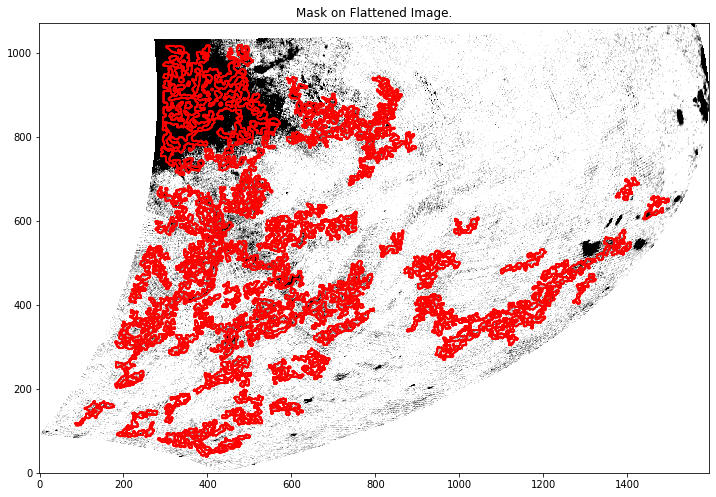

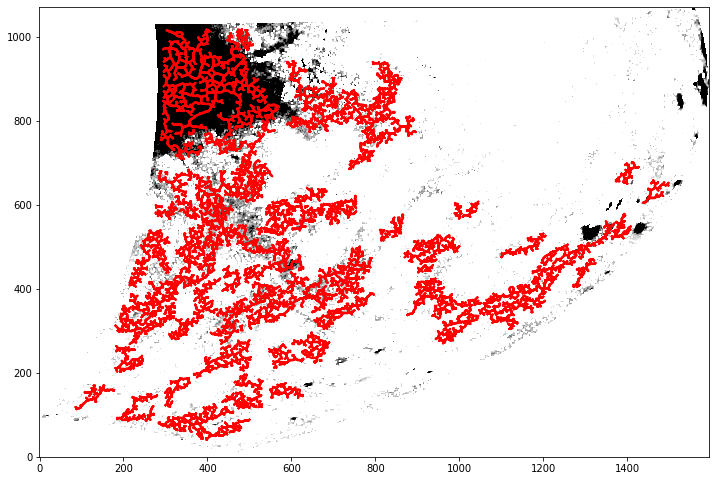

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")


<Figure size 720x648 with 0 Axes>

In [17]:
w = WCS(hdu)


v_start,v_end,d,bmaj,cdelt,vmin,vmax = -100,-70,10,0.2706,0.083333333,0.01,20
##########################
#     wcs = WCS(hdu.header)
##########################


integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -cdelt
hdr1["CDELT2"] = cdelt
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
#     hdr1["BPA"] = integ_hdu.header["BPA"]
#     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
#     hdr1["BMIN"] = integ_hdu.header["BMIN"]
#     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
#     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

fil.preprocess_image(flatten_percent=95)
fil.create_mask(verbose=True)
fil.medskel(verbose=True)
fil_skeleton= fil.skeleton
fil_skeleton = fil_skeleton.astype("int")
hdr2 = copy.deepcopy(hdu.header)
hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
hdr2["NAXIS"]=2
hdr2["WCSAXES"]=2

fig = aplpy.FITSFigure(integ_hdu,slices=[0])
fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="sqrt",cmap="nipy_spectral")
fig.add_colorbar()
fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
fig.add_grid()
fig.set_title("%ikm/s~%ikm/s_distance = %ipc"%(v_start,v_end,d))
# fig.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i.png"%(v_start,v_end,d))
# integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)


plt.clf()

fil.analyze_skeletons()
fil.exec_rht()

ypos = np.array([f.position()[0].value for f in fil.filaments])

########################################

# print(fil.filaments[0].position())
# print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0,0))
# print(fil.filaments[0].orientation)
#     print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0))
########################################

########################################

lean_ls = []
pa_deg_map = np.zeros(hdu.data.shape[1:])
for i in range(hdu.data.shape[2]): #1595
    for j in range(hdu.data.shape[1]): #1071
        
        pos = w.wcs_pix2world(i,j,0,0)
#         pos = w.wcs_pix2world(j,i,0,0) kottihamatigai
        if np.isnan(pos[0])==True or np.isnan(pos[1])==True:
            lean_ls.append(0)
            pa_deg_map[[j],[i]]=np.nan
            continue
        slide_plus = np.array([pos[0],pos[1]+0.0001])
        slide_minus = np.array([pos[0],pos[1]-0.0001])
        slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
        slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
        vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
#         vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
        lean = -vec[0]/vec[1]  #
#         print(lean)
#         print(np.arctan(lean))
        lean_ls.append(np.rad2deg(np.arctan(lean)))
        pa_deg_map[[j],[i]]=np.rad2deg(np.arctan(lean))
        
                    






########################################
# ori = np.array(np.rad2deg(fil.orientation))
# ori2 = ori
# ori2 = ori2[ypos<=800]
# plt.hist(ori2,alpha=0.5,bins=np.linspace(-90,90,num=18))
# plt.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i_hist.png"%(v_start,v_end,d))

In [32]:
pa_deg_map.shape

(1071, 1595)

In [38]:
pa_deg_map[1070][1594]

19.911252704187117

In [23]:
pa_deg_map[[],[100]]

IndexError: index 1500 is out of bounds for axis 0 with size 1071

In [26]:
prac_array = np.array([[1,2,3],[4,5,6],[7,8,9]])
prac_array

array([[1, 2, 3],
       [4, 5, 6],
       [7, 8, 9]])

In [29]:
prac_array[[1],[2]]

array([6])

In [30]:
prac_array[1][2]

6

In [20]:
pa_deg_map.shape

(1071, 1595)

In [21]:
pa_deg_map[1200][1300]

IndexError: index 1200 is out of bounds for axis 0 with size 1071

In [39]:
hdu.data.shape[2],hdu.data.shape[1]

(1595, 1071)

In [40]:
hdu.data.shape[2]

1595

In [19]:
pos = w.wcs_pix2world(20000,20000,0,0)
pos

[array(nan), array(nan), array(-600207.21820852)]

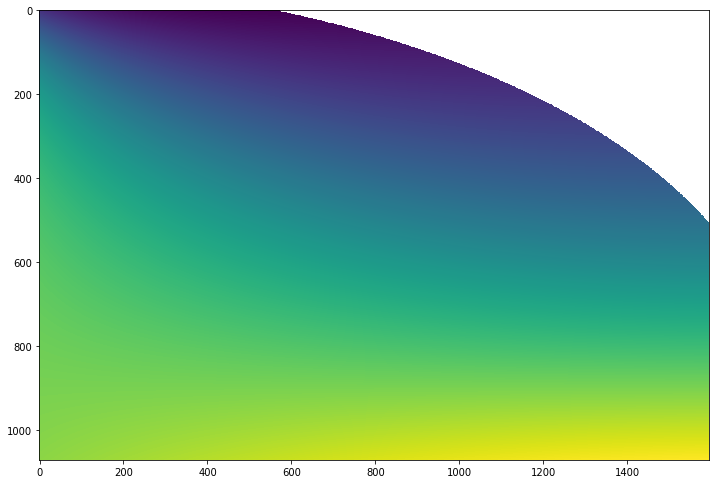

In [20]:
plt.imshow(pa_deg_map)

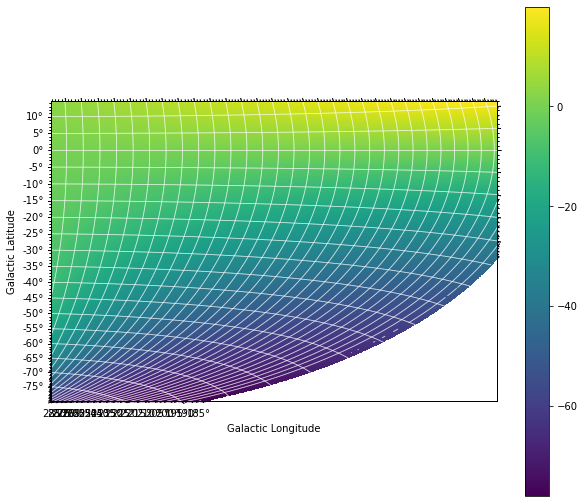

In [21]:
fig = aplpy.FITSFigure(integ_hdu,slices=[0])
plt.imshow(pa_deg_map)
fig.add_grid()
plt.colorbar()
fig.ticks.set_xspacing(5)
fig.ticks.set_yspacing(5)

In [19]:
lean_ls = []
pa_deg_map = np.zeros(hdu.data.shape[1:])
for i in range(hdu.data.shape[2]):
    for j in range(hdu.data.shape[1]):
        
        pos = w.wcs_pix2world(i,j,0,0)
        if np.isnan(pos[0])==True or np.isnan(pos[1])==True:
            lean_ls.append(0)
            pa_deg_map[[j],[i]]=np.nan
            continue
        slide_plus = np.array([pos[0],pos[1]+0.0001])
        slide_minus = np.array([pos[0],pos[1]-0.0001])
        slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
        slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
        vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
#         vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
        lean = -vec[0]/vec[1]  #
#         print(lean)
#         print(np.arctan(lean))
        lean_ls.append(np.rad2deg(np.arctan(lean)))
        pa_deg_map[[j],[i]]=np.rad2deg(np.arctan(lean))
        
        
    

TypeError: WCS projection has 2 dimensions, so expected 2 (an Nx2 array and the origin argument) or 3 arguments (the position in each dimension, and the origin argument). Instead, 4 arguments were given.

In [37]:
hdu.data.shape

(933, 1072, 1505)

In [38]:
pa_deg_map.shape

(1072, 1505)

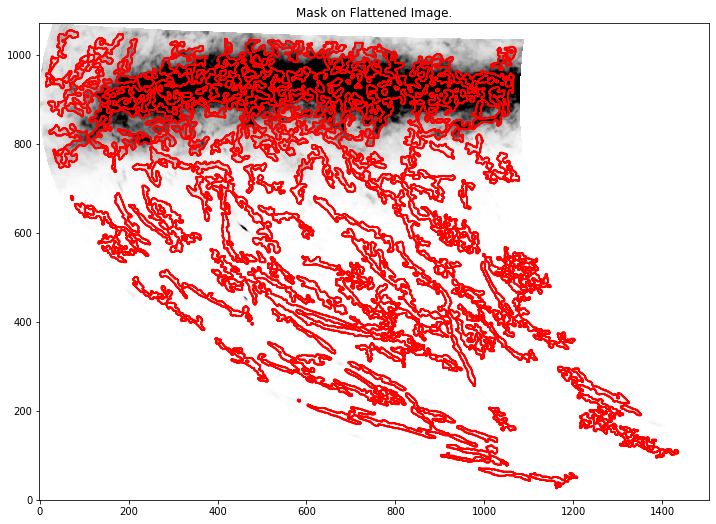

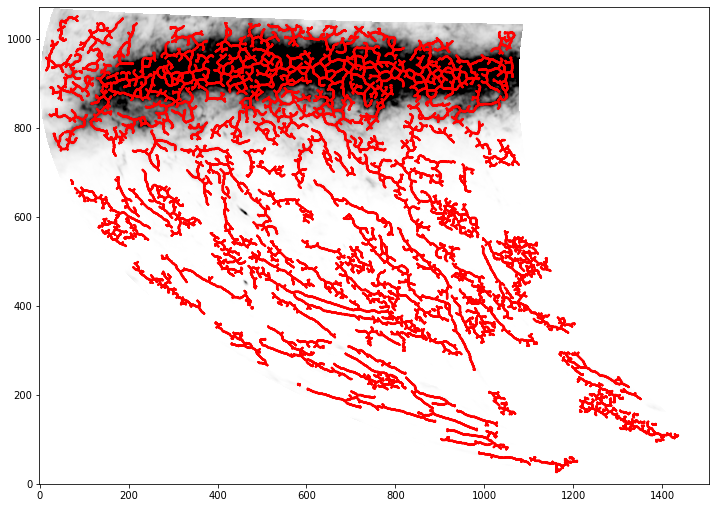

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))


In [75]:
fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

fil.preprocess_image(flatten_percent=95)
fil.create_mask(verbose=True)
fil.medskel(verbose=True)
fil_skeleton= fil.skeleton
fil_skeleton = fil_skeleton.astype("int")
fil.analyze_skeletons()
fil.exec_rht()

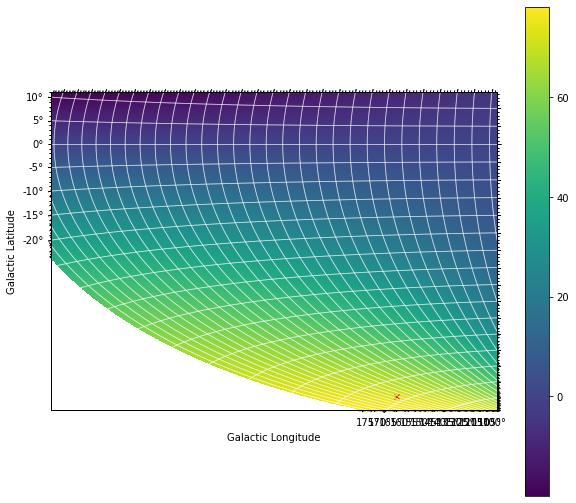

In [49]:
######################################################################

fig = aplpy.FITSFigure(integ_hdu,slices=[0])

plt.imshow(pa_deg_map)
fig.add_grid()
plt.colorbar()
fig.ticks.set_xspacing(5)
fig.ticks.set_yspacing(5)


plt.plot(fil.filaments[0].position()[1].value,fil.filaments[0].position()[0].value,color="red",marker="x",markersize=5)

######################################################################

In [51]:
ypos = np.array([f.position()[0].value for f in fil.filaments])

In [97]:
fil121=fil.filaments[121]

In [99]:
fil121.width_analysis(integ_hdu.data,deconvolve_width=False)

In [100]:
fil121.total_intensity()

<Quantity 56583.85636223>

In [55]:
ypos.shape

(122,)

In [60]:
ypos

array([  46. ,   59. ,   50. ,   98. ,  123. ,  172. ,  144.5,  159.5,
        170. ,  167. ,  159.5,  184.5,  193. ,  193. ,  211. ,  202. ,
        240. ,  240.5,  227. ,  261. ,  292. ,  276. ,  314.5,  315. ,
        312. ,  306. ,  318. ,  373.5,  334. ,  360. ,  336. ,  333. ,
        387. ,  361. ,  391. ,  378. ,  412.5,  410. ,  447. ,  405.5,
        398. ,  440. ,  456.5,  411. ,  433. ,  443. ,  449. ,  471. ,
        428. ,  520. ,  498. ,  480. ,  467. ,  474.5,  484. ,  486. ,
        495. ,  511. ,  525. ,  521. ,  527. ,  520. ,  529. ,  537. ,
        556. ,  567. ,  545. ,  609. ,  597. ,  627. ,  581. ,  618. ,
        570. ,  602.5,  617.5,  599. ,  637.5,  636. ,  647.5,  639.5,
        683. ,  715. ,  698. ,  690. ,  736.5,  698. ,  735. ,  712.5,
        708. ,  750. ,  728. ,  748. ,  778. ,  733. ,  912. ,  777. ,
        760. ,  749. ,  761. ,  796. ,  795. ,  795. ,  789. ,  799. ,
        810. ,  792. ,  838. ,  841. ,  931.5,  929. ,  897. ,  892. ,
      

In [50]:
fil.filaments[0].position()

[<Quantity 46. pix>, <Quantity 1162. pix>]

In [46]:
fil_ori = []

for fil in fil.filaments:
    pa = (90-pa_deg_map[int(fil.position()[0].value)][int(fil.position()[1].value)])+np.rad2deg(fil.orientation.value)
    fil_ori.append(pa)

In [52]:
fil_ori_ = []
for fil in fil.filaments:
    pa = np.rad2deg(fil.orientation.value)-pa_deg_map[int(fil.position()[0].value)][int(fil.position()[1].value)]
    fil_ori_.append(pa)

In [452]:
np.rad2deg(fil.filaments[0].orientation.value)-pa_deg_map[int(fil.filaments[0].position()[0].value)][int(fil.filaments[0].position()[1].value)]

9.72907506643864

In [454]:
fil.filaments[0].orientation

<Quantity 1.43996707 rad>

In [455]:
fil.filaments[0].position()

[<Quantity 46. pix>, <Quantity 1162. pix>]

In [444]:
len(fil.filaments)

122

In [63]:
fil_ori_=np.array(fil_ori_)

(array([ 0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  4.,  5.,  4.,  6., 32.,
        42., 13., 12.,  3.]),
 array([-180.        , -158.82352941, -137.64705882, -116.47058824,
         -95.29411765,  -74.11764706,  -52.94117647,  -31.76470588,
         -10.58823529,   10.58823529,   31.76470588,   52.94117647,
          74.11764706,   95.29411765,  116.47058824,  137.64705882,
         158.82352941,  180.        ]),
 <BarContainer object of 17 artists>)

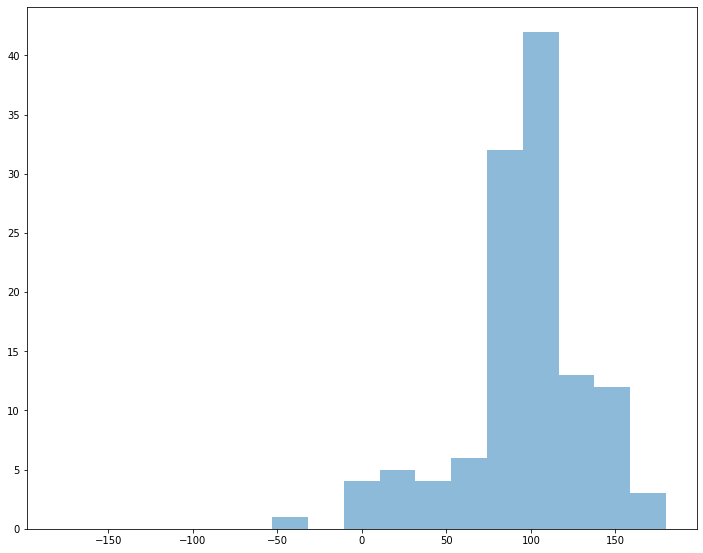

In [446]:
plt.hist(fil_ori,alpha=0.5,bins=np.linspace(-180,180,num=18))

In [ ]:
fil_ori_=np.where(fil_ori_<-90,fil_ori_+180,fil_ori_)
#-90deg以下のものには+180deg、90deg以上のものには-180degをして±90degの範囲に収める。

(array([ 2.,  0.,  1.,  0.,  1.,  2.,  2., 10., 19., 21., 20.,  6.,  3.,
        12.,  3.,  2.,  0.]),
 array([-90.        , -79.41176471, -68.82352941, -58.23529412,
        -47.64705882, -37.05882353, -26.47058824, -15.88235294,
         -5.29411765,   5.29411765,  15.88235294,  26.47058824,
         37.05882353,  47.64705882,  58.23529412,  68.82352941,
         79.41176471,  90.        ]),
 <BarContainer object of 17 artists>)

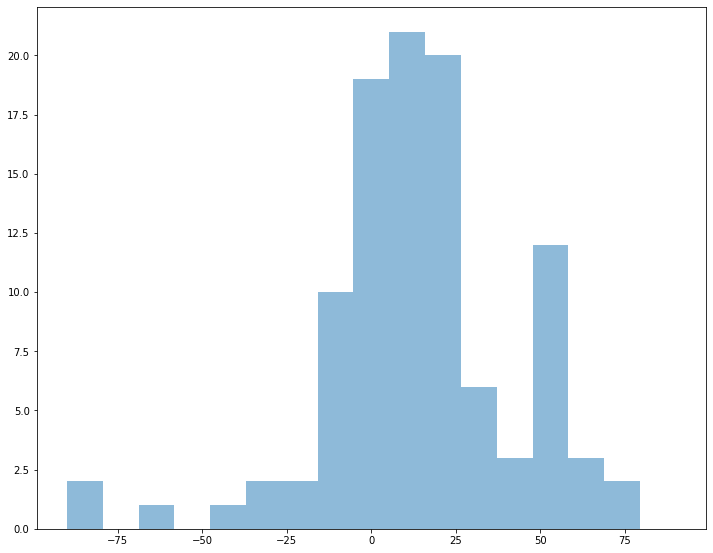

In [73]:
plt.hist(fil_ori_[ypos<800],alpha=0.5,bins=np.linspace(-90,90,num=18))


In [408]:
# pos = w.wcs_pix2world(200,200,0,0)
# print(pos[1])

In [409]:
# slide_plus = [pos[0],pos[1]+0.0001]
# slide_minus = [pos[0],pos[1]-0.0001]
# slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
# slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
# print(slide_plus_pix)
# print(slide_minus_pix)
# vec = np.array(slide_plus_pix) - np.array(slide_minus_pix)
# print(vec)
# lean = vec[1]/vec[0]
# print(lean)
# print(np.rad2deg(np.arctan(lean)))

In [255]:
# pos = w.wcs_pix2world(0,600,0,0)
# slide_plus = np.array([pos[0]+0.0001,pos[1]])
# slide_minus = np.array([pos[0]-0.0001,pos[1]])
# slide_plus_pix = w.wcs_world2pix(slide_plus[0],slide_plus[1],0,0)
# slide_minus_pix = w.wcs_world2pix(slide_minus[0],slide_minus[1],0,0)
# vec = np.array([slide_plus_pix[0]-slide_minus_pix[0],slide_plus_pix[1]-slide_minus_pix[1]])
# lean = vec[1]/vec[0]
# print(lean)
# print(np.arctan(lean))
# print(np.rad2deg(np.arctan(lean)))

0.14262728363937804
0.14167178532533398
8.117195375225068


In [411]:
# make_integ_filament_array(hdu,-50,-20,10,0.2706,0.083333333,1,450)

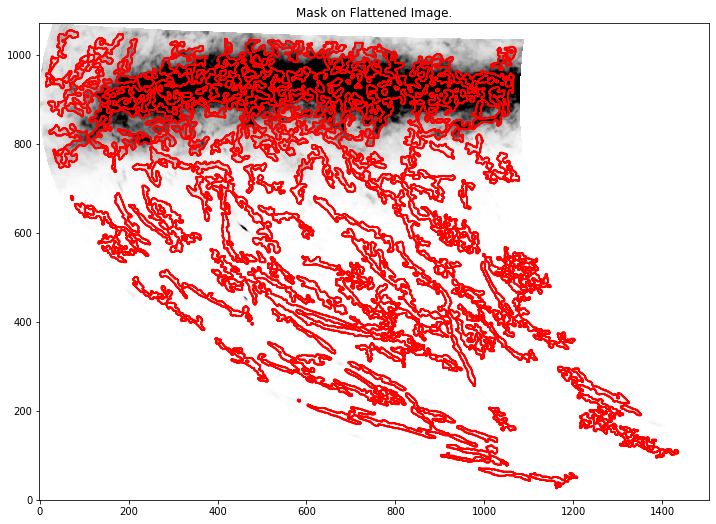

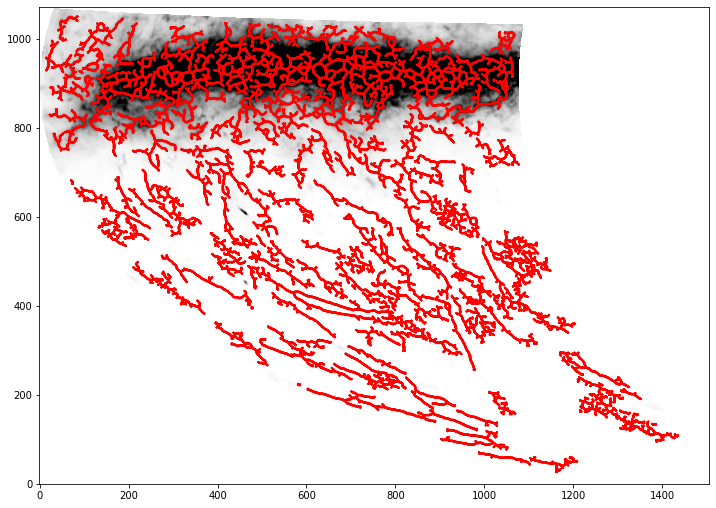

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")
/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/length.py:204: RuntimeWarning: Mean of empty slice
  av_intensity.append(np.nanmean(intensities))


(array([ 3.,  1.,  1.,  1.,  0.,  0.,  0.,  2.,  4.,  4.,  3.,  9., 15.,
        19., 19., 14.,  9.]),
 array([-90.        , -79.41176471, -68.82352941, -58.23529412,
        -47.64705882, -37.05882353, -26.47058824, -15.88235294,
         -5.29411765,   5.29411765,  15.88235294,  26.47058824,
         37.05882353,  47.64705882,  58.23529412,  68.82352941,
         79.41176471,  90.        ]),
 <BarContainer object of 17 artists>)

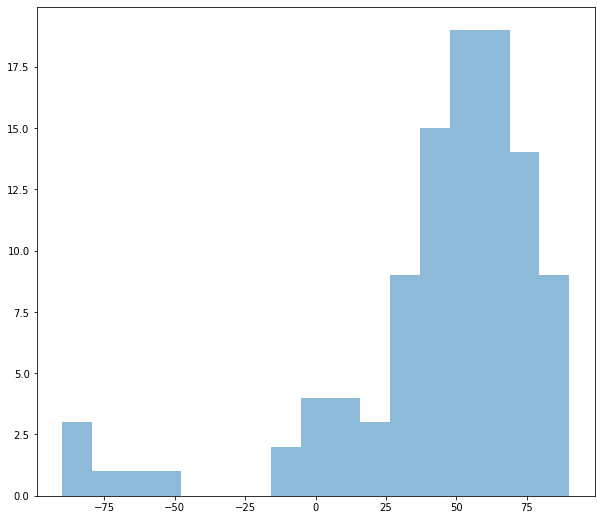

In [451]:
w = WCS(hdu)


v_start,v_end,d,bmaj,cdelt,vmin,vmax = -100,-70,10,0.2706,0.083333333,0.01,20
##########################
#     wcs = WCS(hdu.header)
##########################


integ_hdu = make_new_hdu_integ(hdu, v_start, v_end, w)
integ_hdu.data[integ_hdu.data<=0.01]=np.nan  ####0.01
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -cdelt
hdr1["CDELT2"] = cdelt
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
#     hdr1["BPA"] = integ_hdu.header["BPA"]
#     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
#     hdr1["BMIN"] = integ_hdu.header["BMIN"]
#     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
#     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=d * u.pc, beamwidth=bmaj* u.deg)

fil.preprocess_image(flatten_percent=95)
fil.create_mask(verbose=True)
fil.medskel(verbose=True)
fil_skeleton= fil.skeleton
fil_skeleton = fil_skeleton.astype("int")
hdr2 = copy.deepcopy(hdu.header)
hdr2 = del_header_key(hdr2, ["CRVAL3", "CRPIX3", "CRVAL3", "CDELT3", "CUNIT3", "CTYPE3", "CROTA3", "NAXIS3", "CNAME3"])
hdr2["NAXIS"]=2
hdr2["WCSAXES"]=2

fig = aplpy.FITSFigure(integ_hdu,slices=[0])
fig.show_colorscale(vmin=vmin,vmax=vmax,stretch="sqrt",cmap="nipy_spectral")
fig.add_colorbar()
fig.show_contour(fits.PrimaryHDU(fil_skeleton,hdr2),colors="r",linewidths=0.5,slices=[0])
fig.add_grid()
fig.set_title("%ikm/s~%ikm/s_distance = %ipc"%(v_start,v_end,d))
# fig.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i.png"%(v_start,v_end,d))
# integ_hdu.writeto("/home/filament/Downloads/fil_remake/%i_%i.fits"%(v_start,v_end), overwrite=True)


plt.clf()

fil.analyze_skeletons()
fil.exec_rht()

ypos = np.array([f.position()[0].value for f in fil.filaments])

########################################

# print(fil.filaments[0].position())
# print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0,0))
# print(fil.filaments[0].orientation)
#     print(w.wcs_pix2world(fil.filaments[0].position()[0],fil.filaments[0].position()[1],0))
########################################

########################################
PA=[]

for f in fil.filaments:
    slide_plus = w.wcs_pix2world(f.position()[1].value+0.5,f.position()[0].value,0,0)
    slide_minus = w.wcs_pix2world(f.position()[1].value-0.5,f.position()[0].value,0,0)
    vec = np.array(slide_plus) - np.array(slide_minus)
    lean = vec[1]/vec[0]
    pa = np.rad2deg(f.orientation.value)+(90-np.rad2deg(np.arctan(lean)))
    PA.append(pa)
                    






########################################
ori = np.array(np.rad2deg(fil.orientation))
ori2 = ori
ori2 = ori2[ypos<=800]
plt.hist(ori2,alpha=0.5,bins=np.linspace(-90,90,num=18))
# plt.savefig("/home/filament/Downloads/fil_remake/%i_%i_%i_hist.png"%(v_start,v_end,d))

(array([ 4.,  4.,  3.,  3.,  1.,  1.,  2.,  2.,  3.,  5.,  4., 13., 20.,
        23., 15., 14.,  4.]),
 array([  0.        ,  10.58823529,  21.17647059,  31.76470588,
         42.35294118,  52.94117647,  63.52941176,  74.11764706,
         84.70588235,  95.29411765, 105.88235294, 116.47058824,
        127.05882353, 137.64705882, 148.23529412, 158.82352941,
        169.41176471, 180.        ]),
 <BarContainer object of 17 artists>)

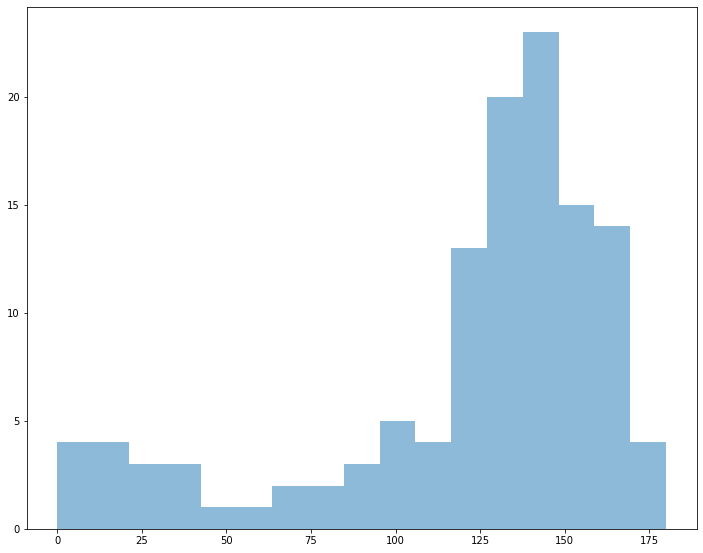

In [121]:
plt.hist(PA,alpha=0.5,bins=np.linspace(0,180,num=18))

In [84]:
print(w.wcs_pix2world(46,1162-0.5,0,0))

[array(164.13982183), array(16.85632959), array(-600207.21820852)]


In [32]:
fil.filaments[0].position()

NameError: name 'fil' is not defined

In [97]:
print(fil.filaments[0].position())
print(w.wcs_pix2world(fil.filaments[0].position()[0].value,fil.filaments[0].position()[1].value-0.5,0,0))
print(fil.filaments[0].orientation)

[<Quantity 46. pix>, <Quantity 1162. pix>]
[array(164.13982183), array(16.85632959), array(-600207.21820852)]
1.4364630511103702 rad


In [110]:
f = fil.filaments[0]
slide_plus = w.wcs_pix2world(f.position()[0].value,f.position()[1].value+0.5,0,0)
slide_minus = w.wcs_pix2world(f.position()[0].value,f.position()[1].value-0.5,0,0)
vec = np.array(slide_plus)- np.array(slide_minus)
lean = vec[0]/vec[1]
print(lean)
print(np.rad2deg(np.arctan(lean)))
pa = np.rad2deg(f.orientation.value)+(90-np.rad2deg(np.arctan(lean)))
pa

1.0252354967441404
45.71389852434554


126.58937173076373

NameError: name 'fil' is not defined

2


/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filfinder2D.py:355: UserWarning: Adaptive thresholding patch is larger than 40pixels. Regridding has been disabled.
  warnings.warn("Adaptive thresholding patch is larger than 40"


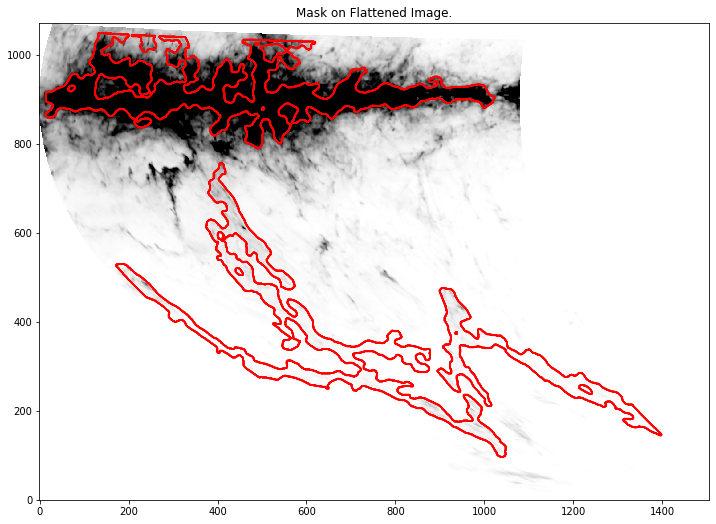

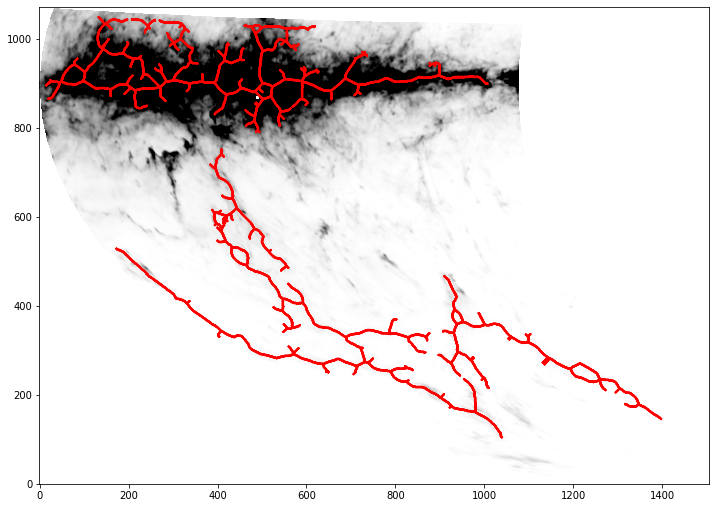

4


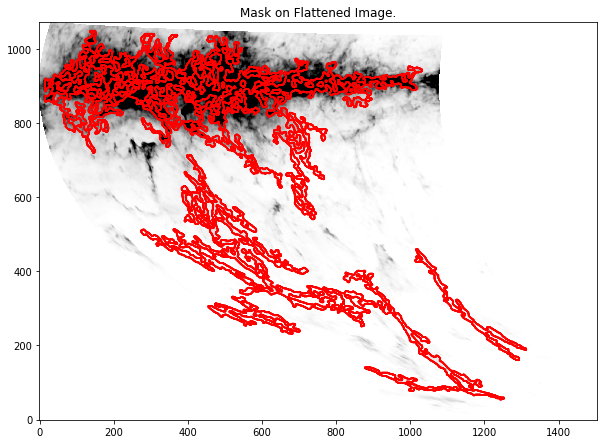

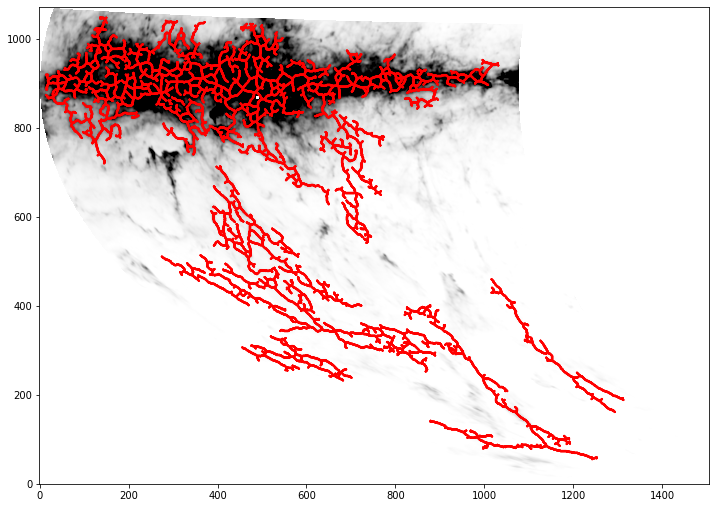

6


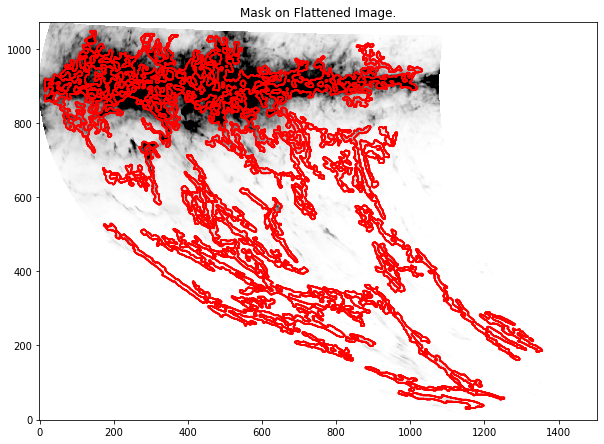

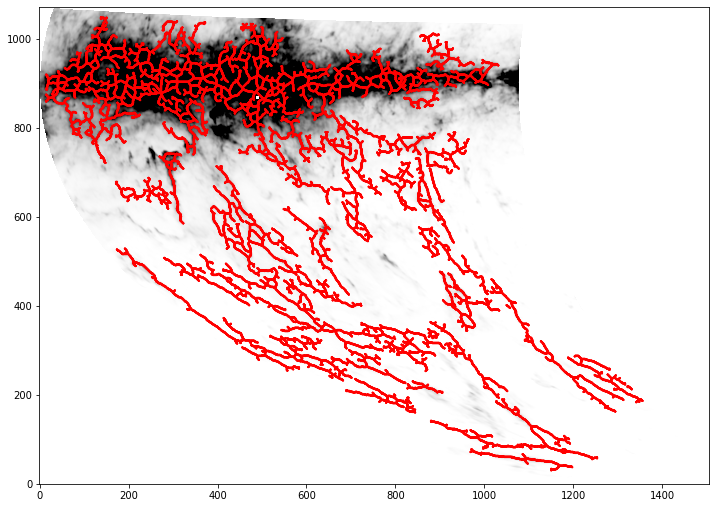

8


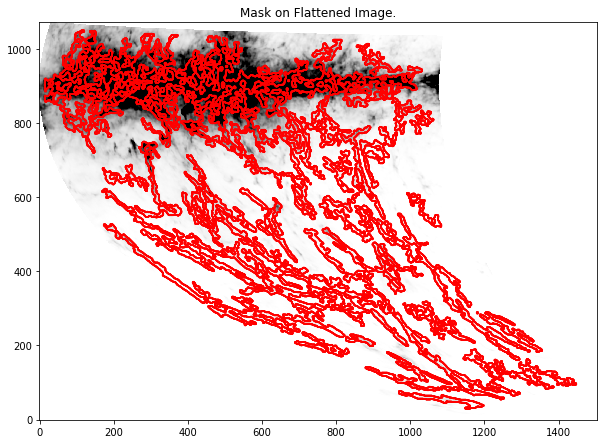

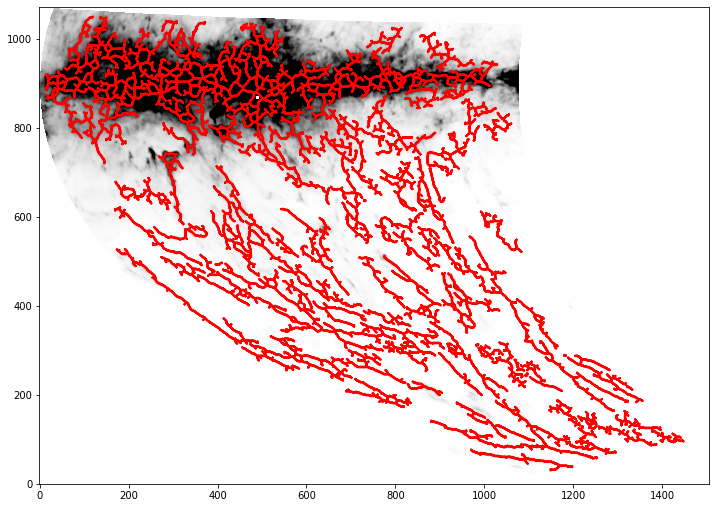

10


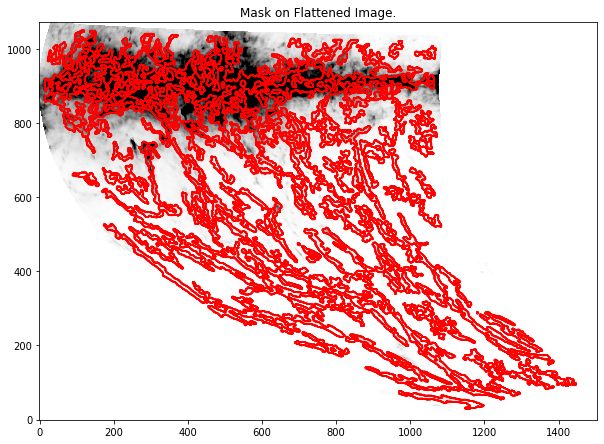

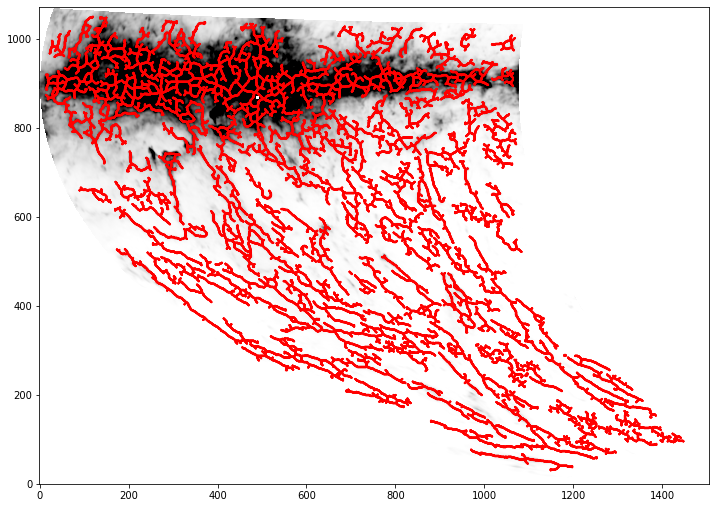

12


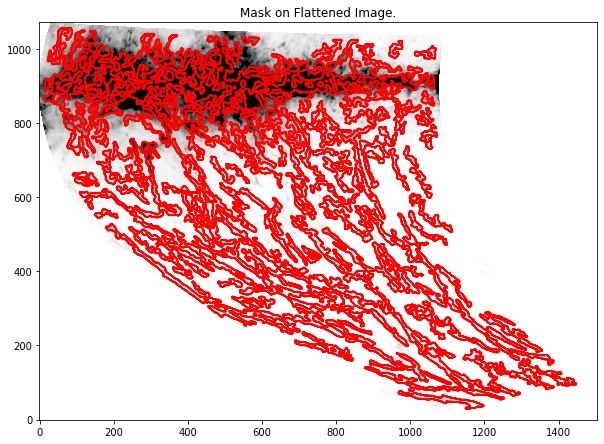

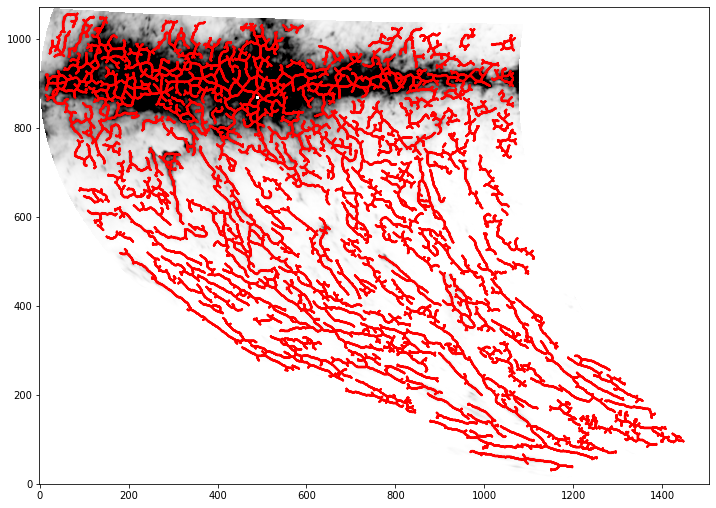

14


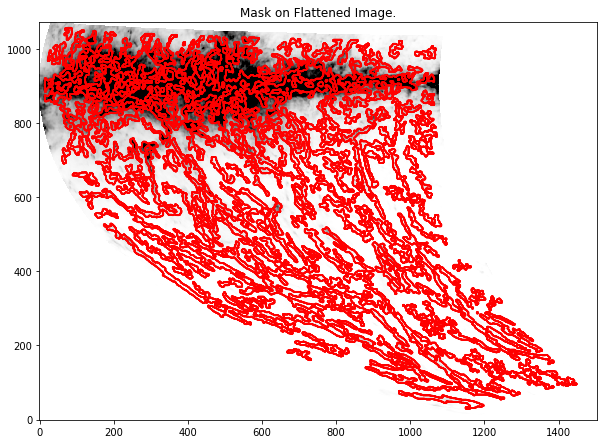

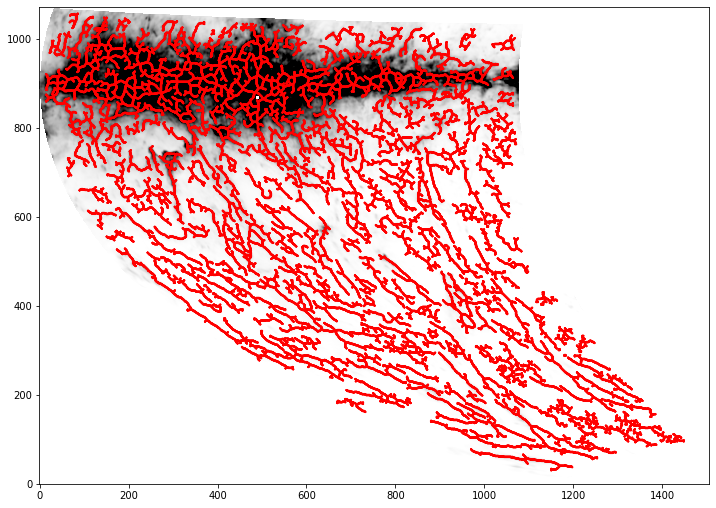

16


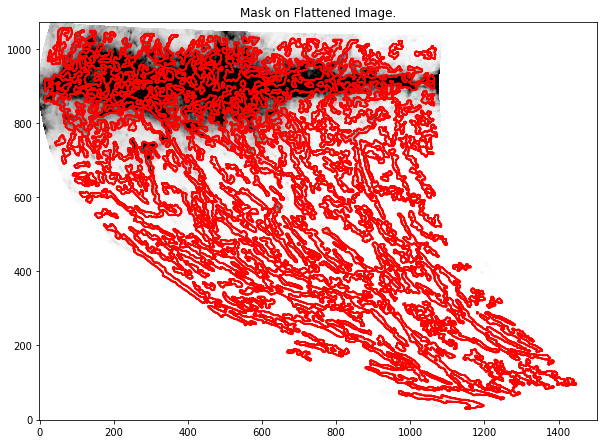

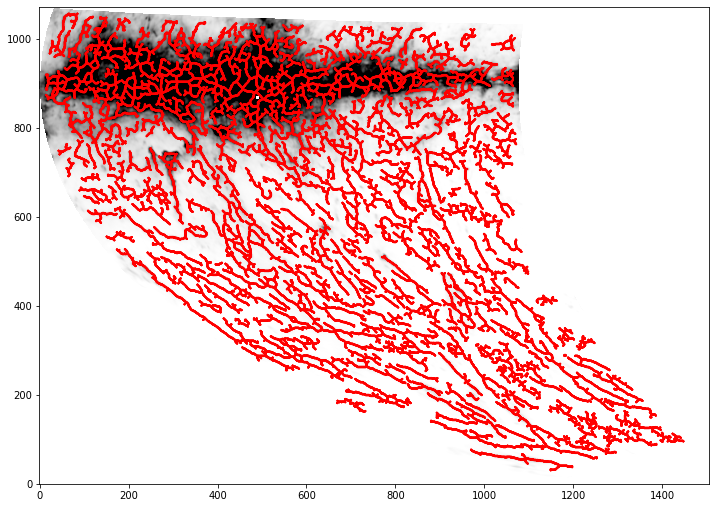

18


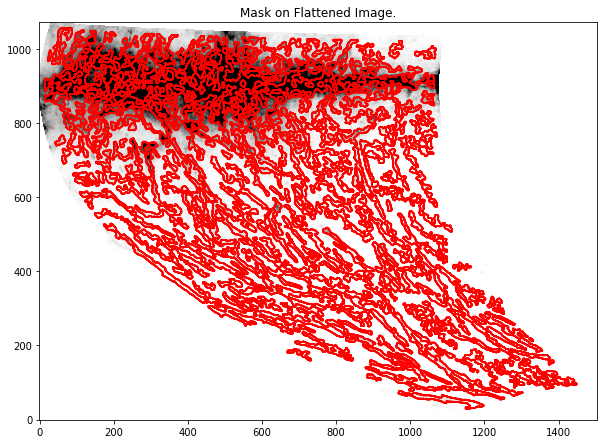

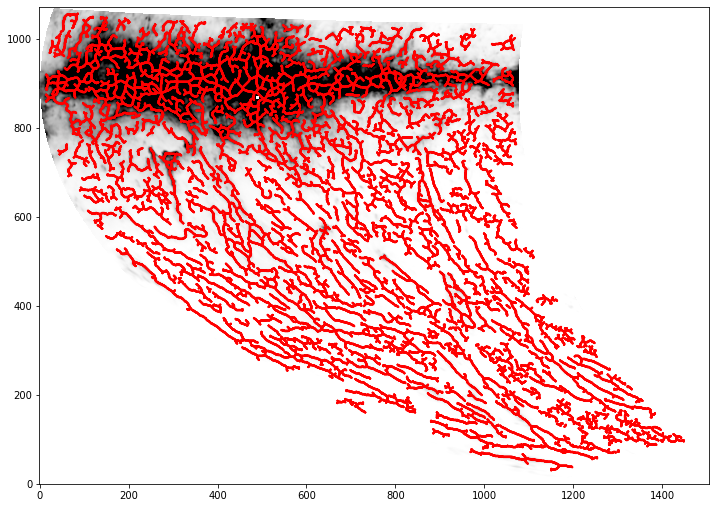

20


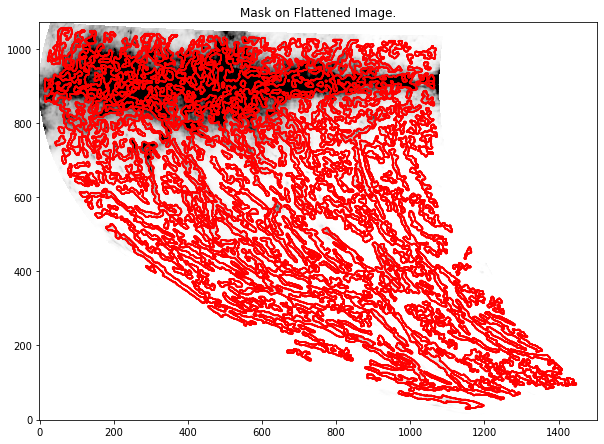

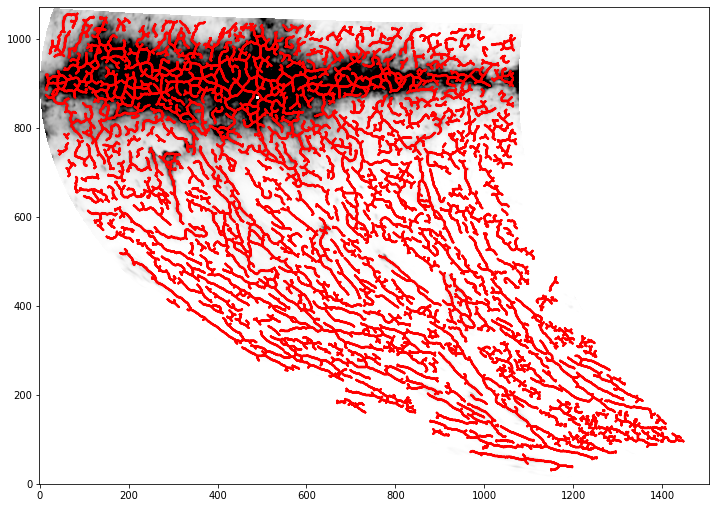

22


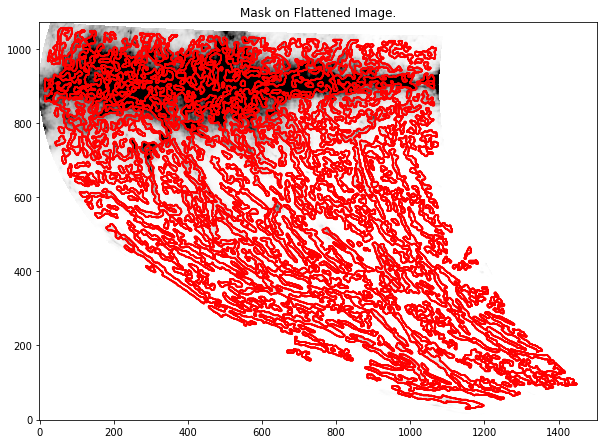

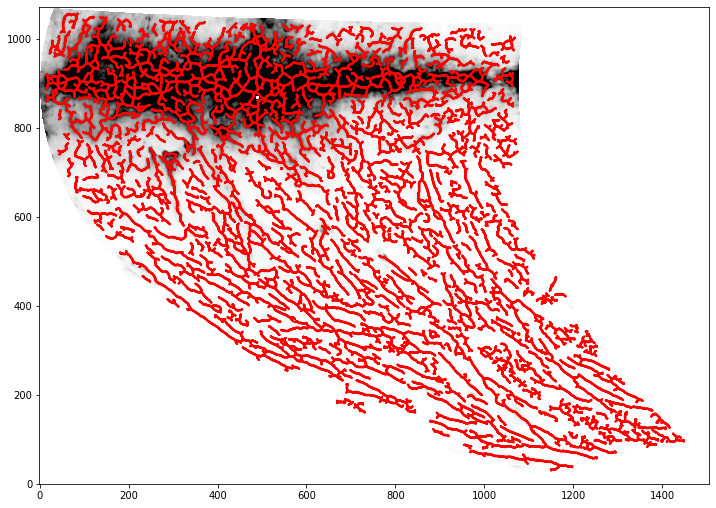

24


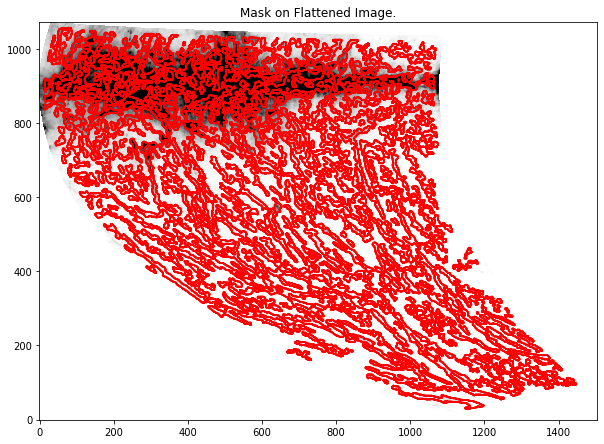

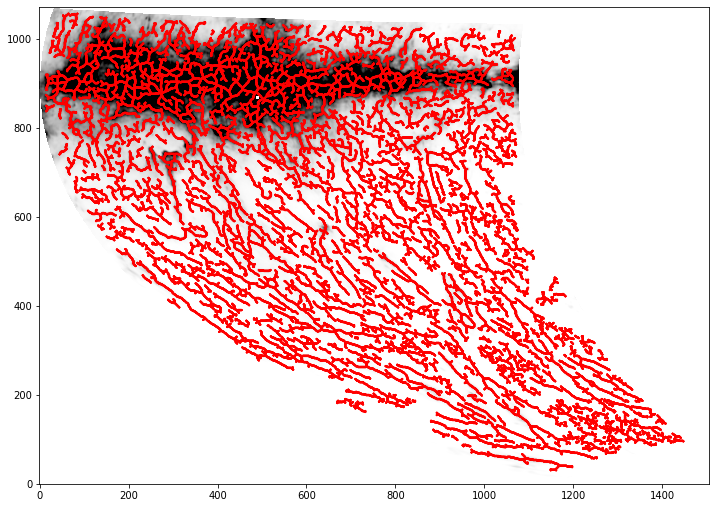

26


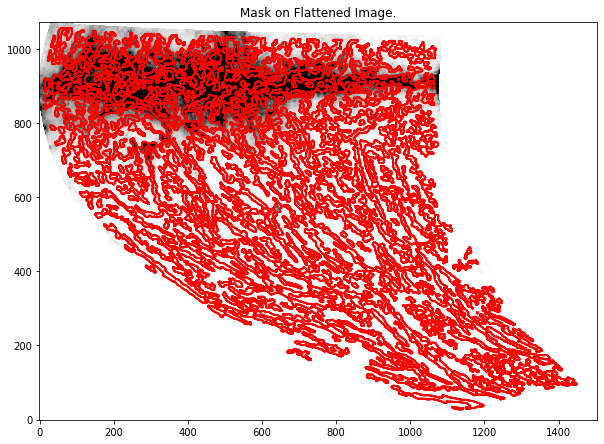

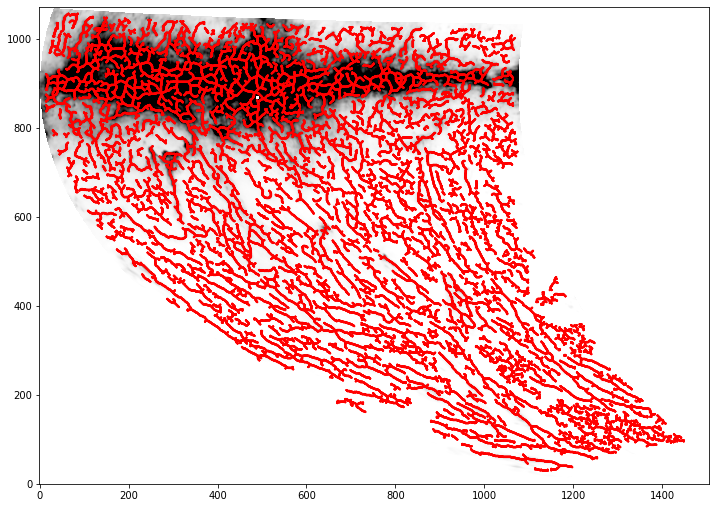

28


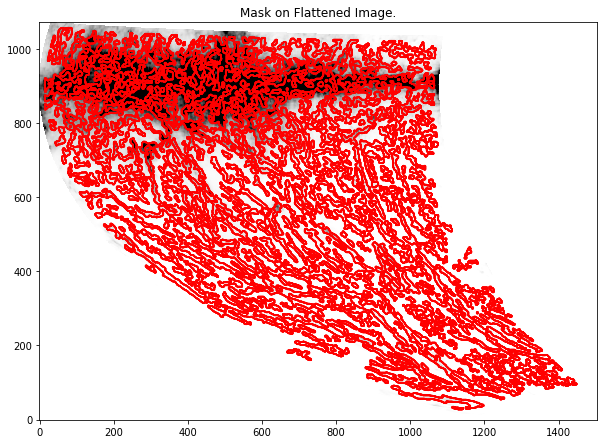

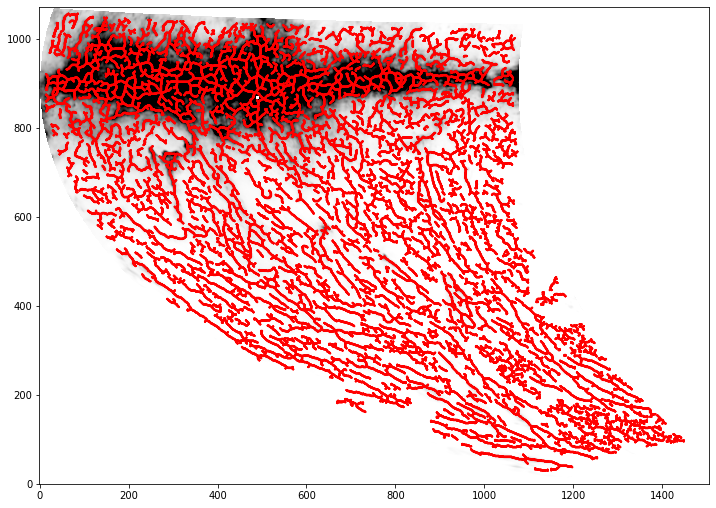

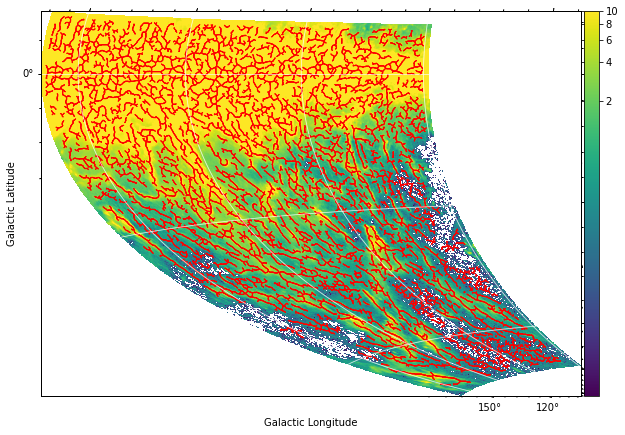

In [99]:
for d in range(2,30,2):
    print(d)
    make_integ_filament_array(hdu,-50,-20,d,0.2706,0.083333333,0.01,10)

-100


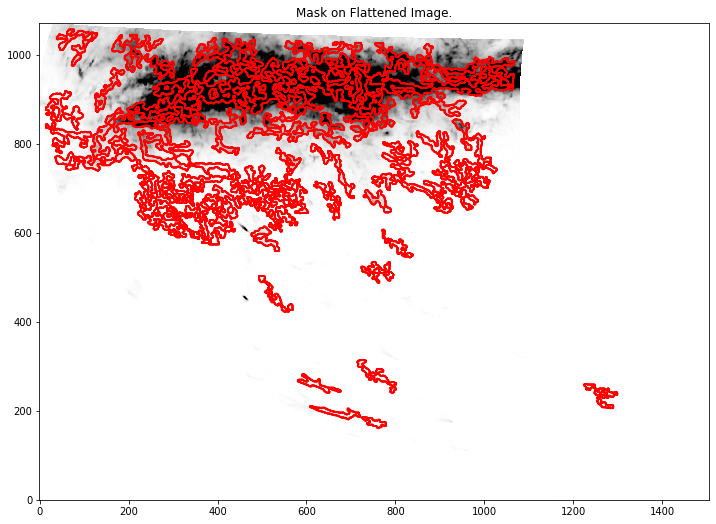

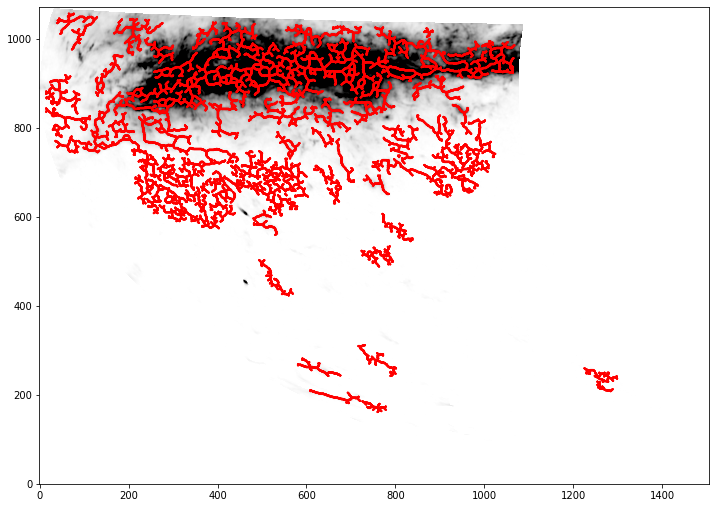

-98


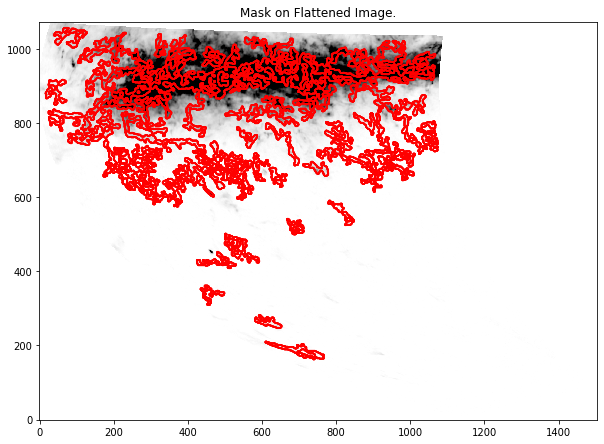

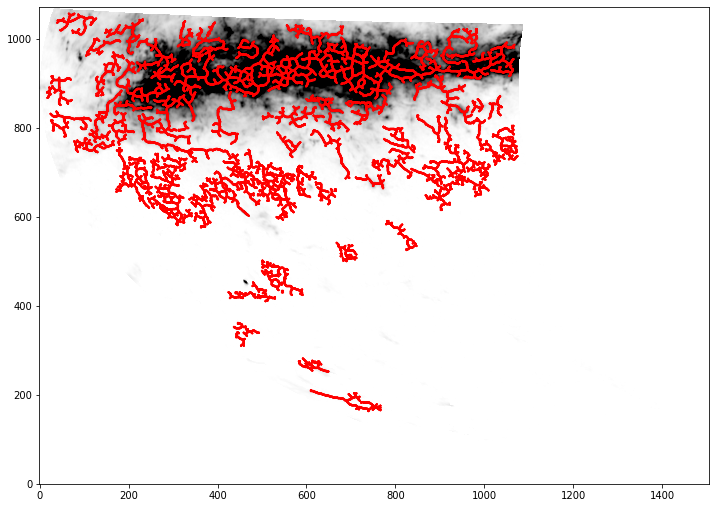

-96


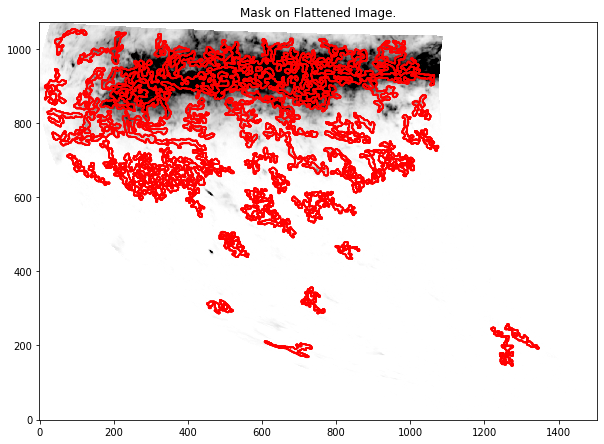

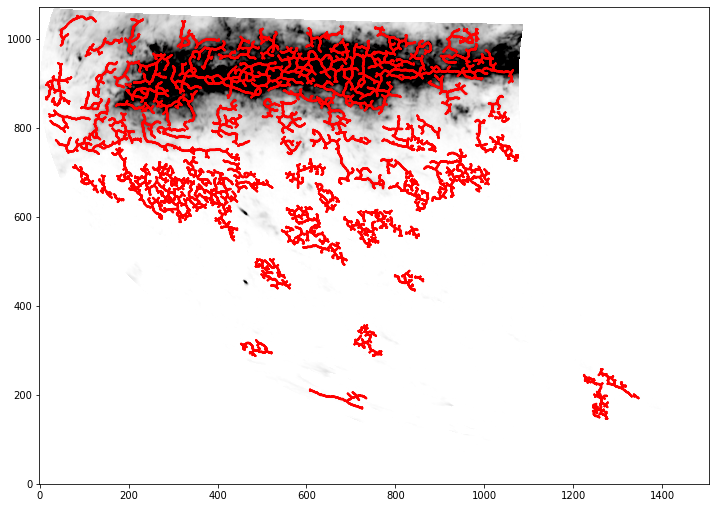

-94


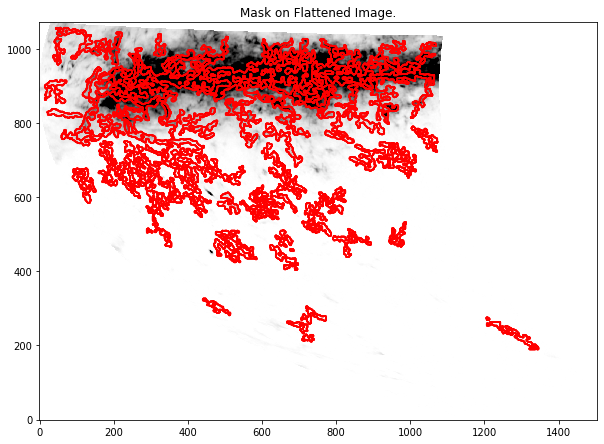

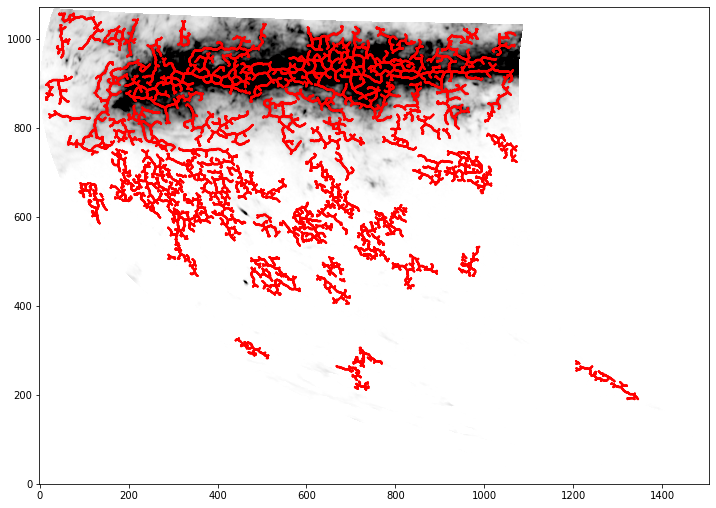

-92


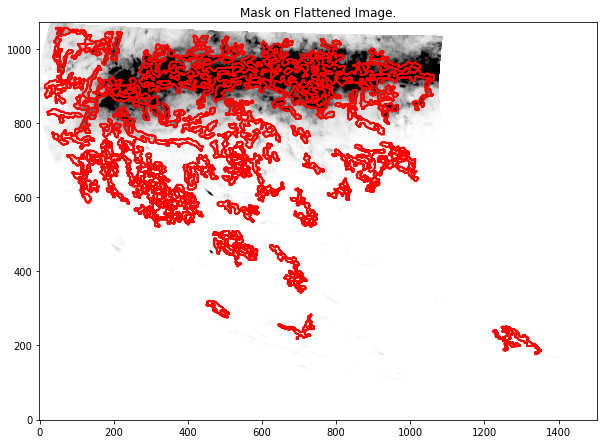

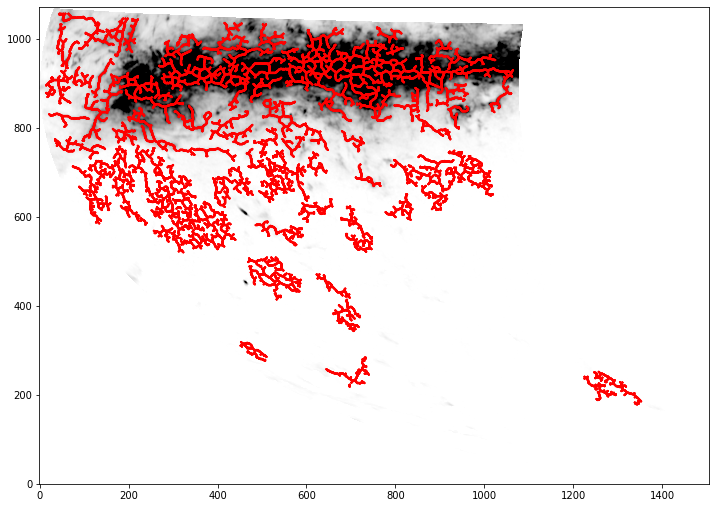

-90


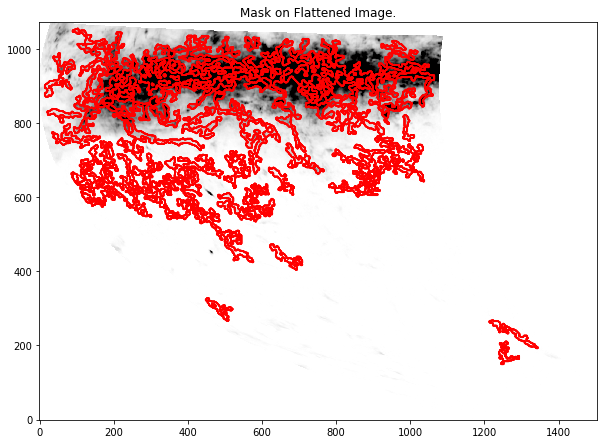

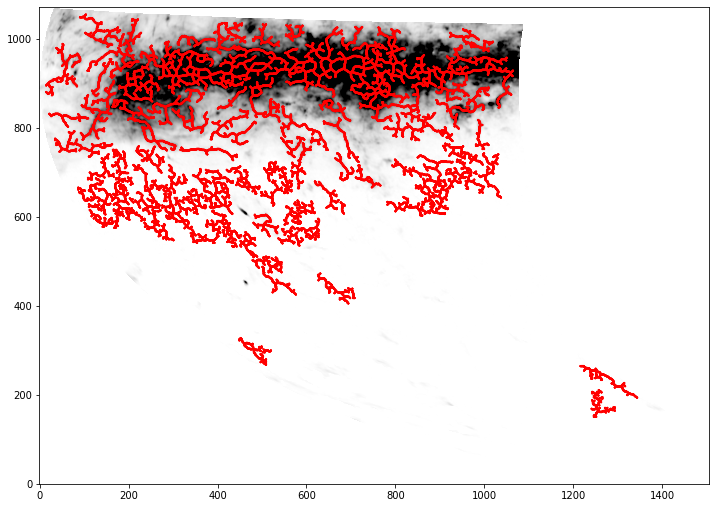

-88


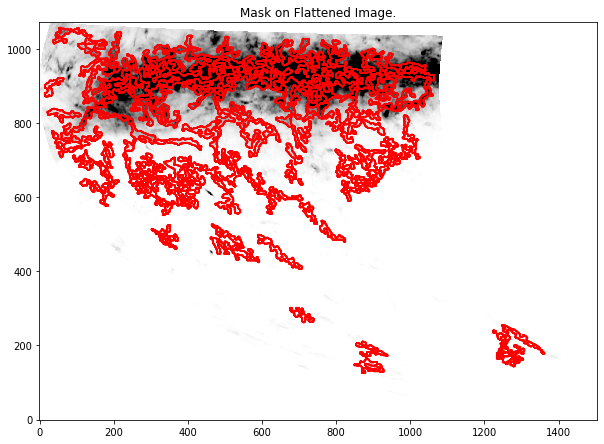

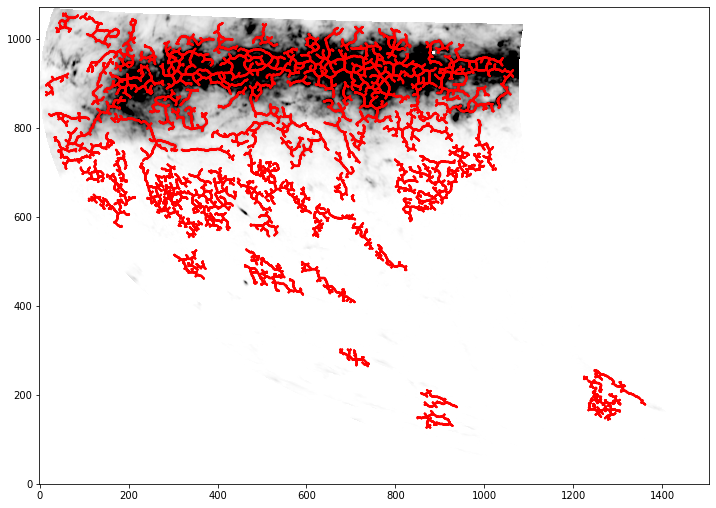

-86


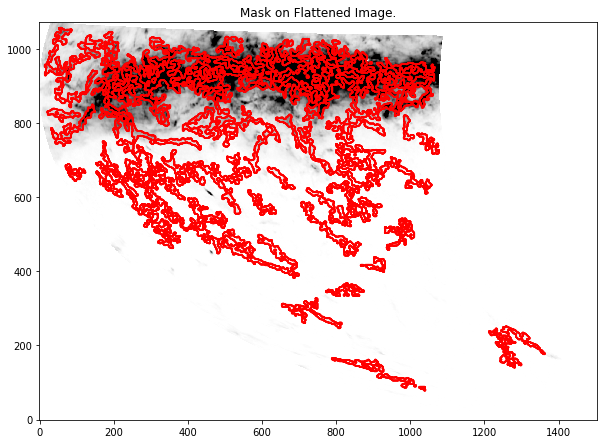

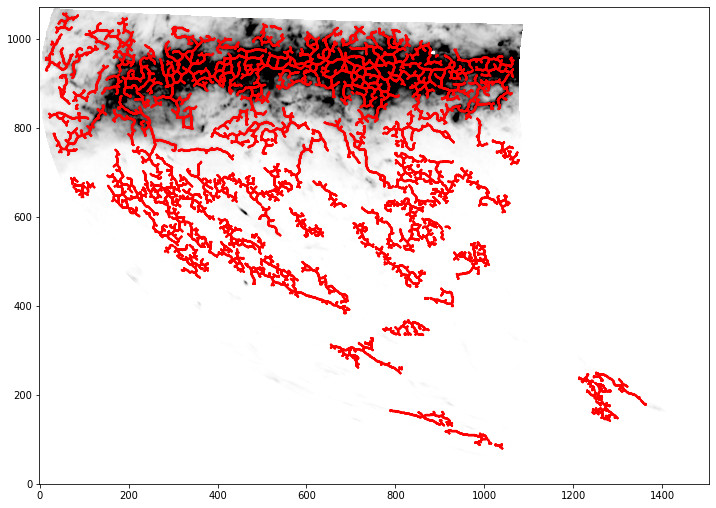

-84


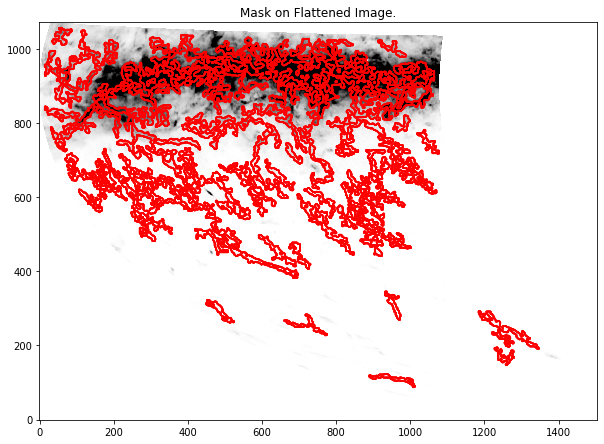

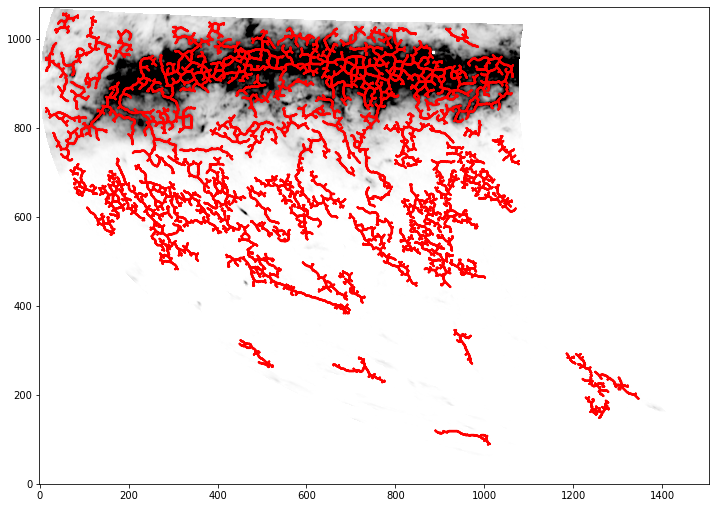

-82


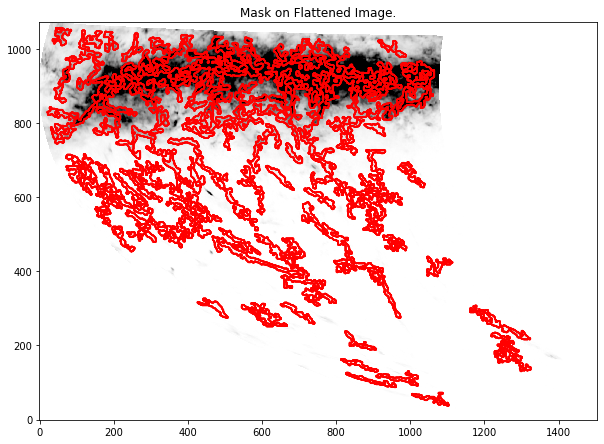

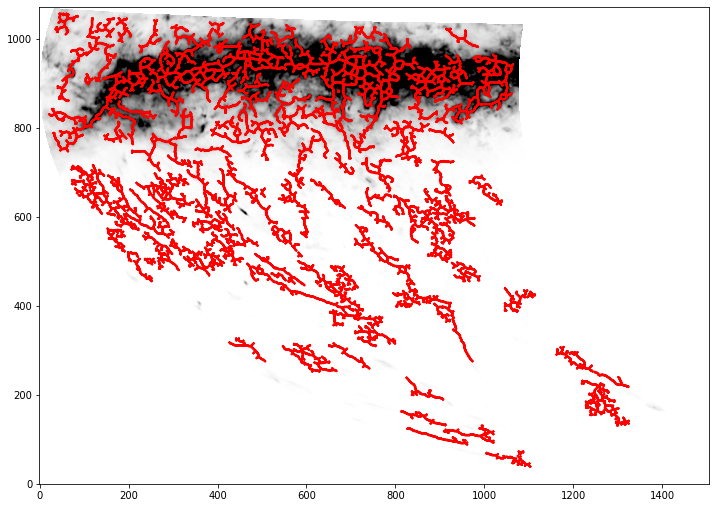

-80


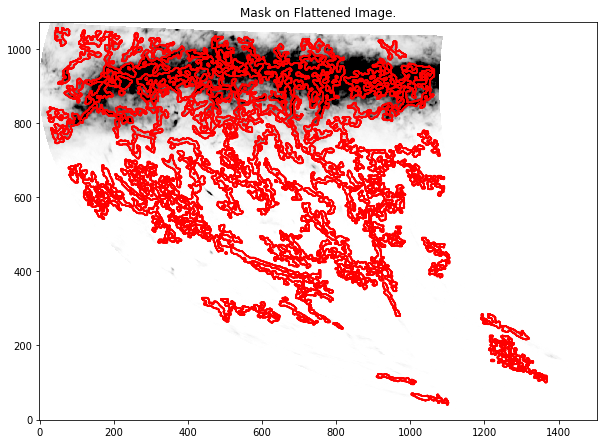

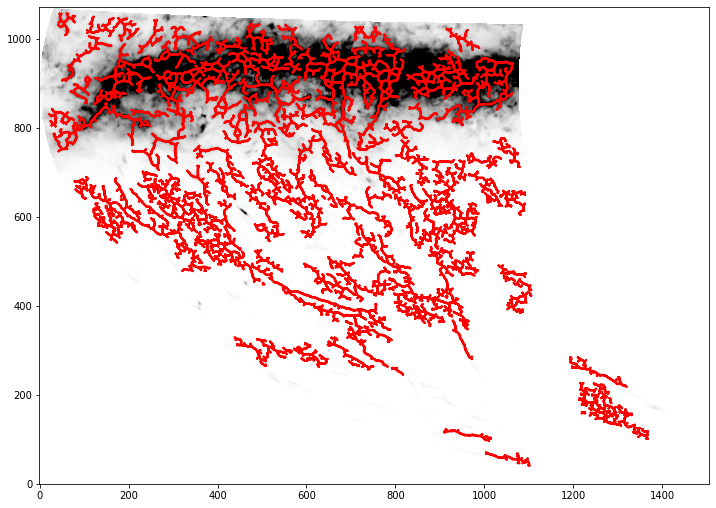

-78


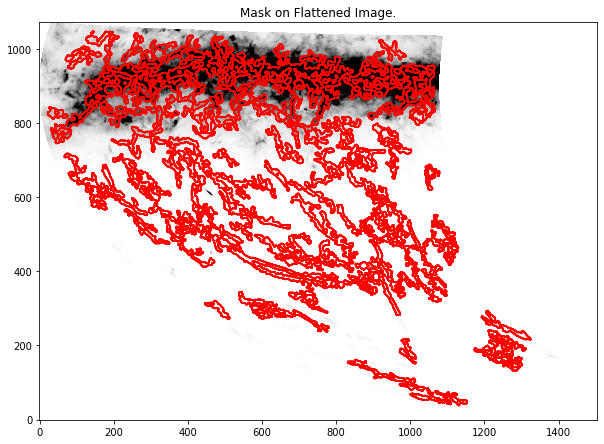

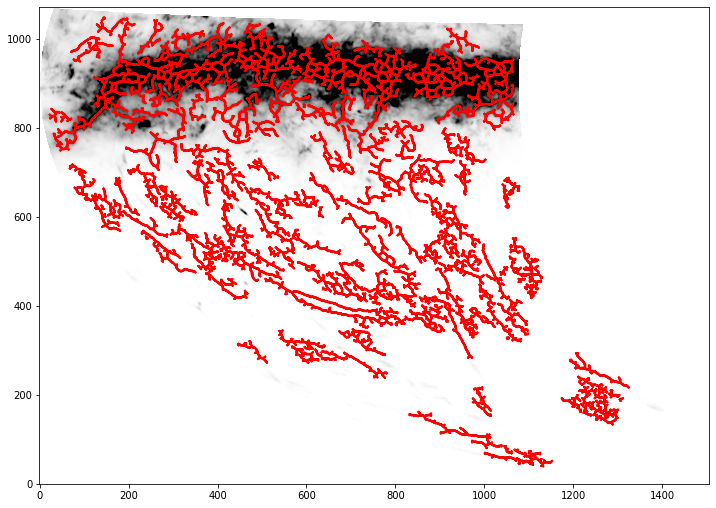

-76


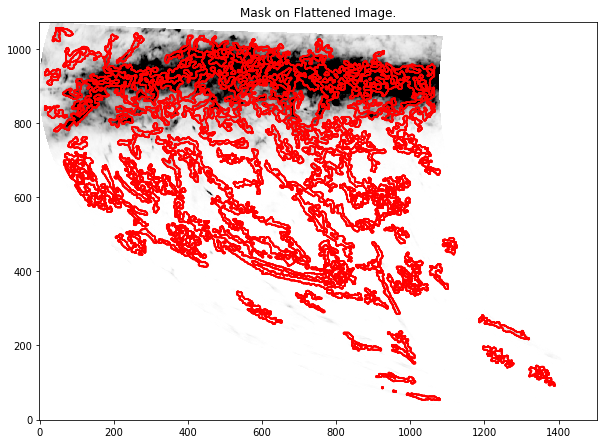

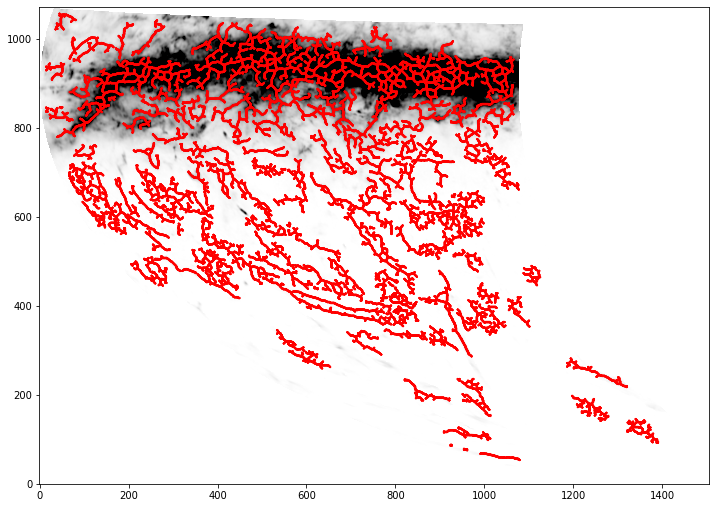

-74


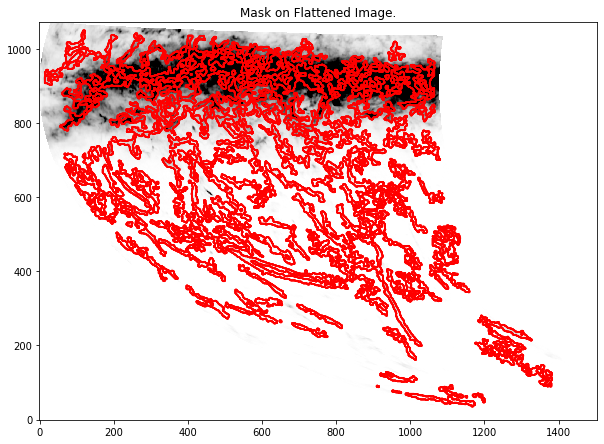

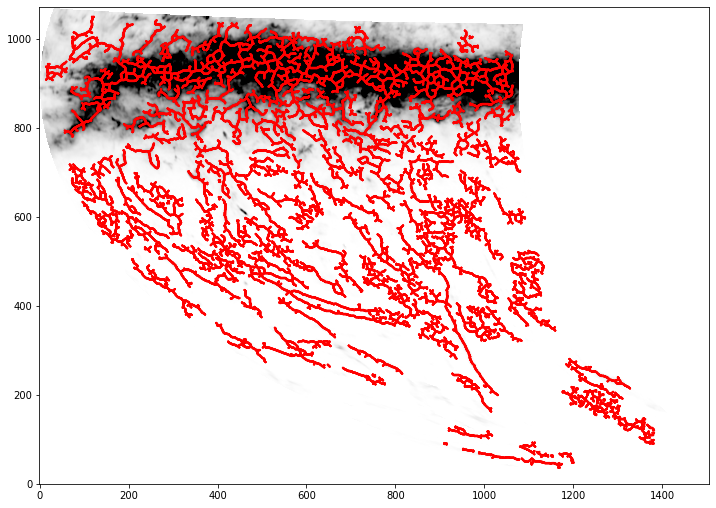

-72


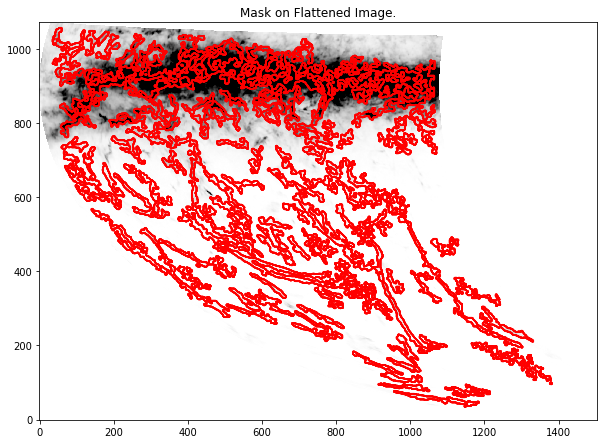

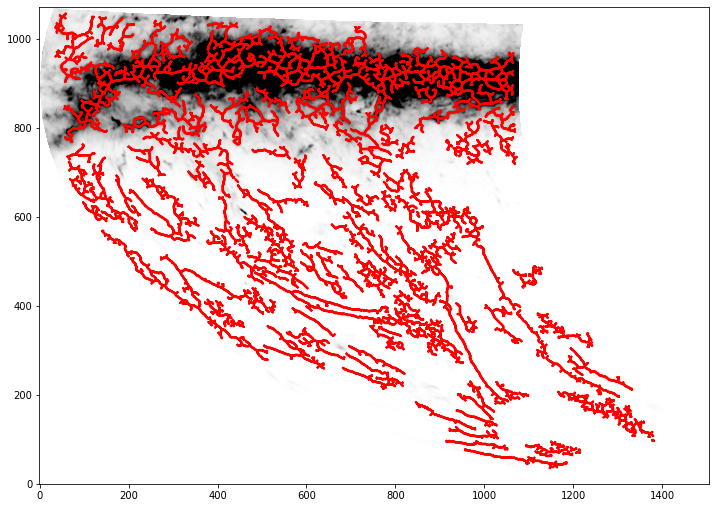

-70


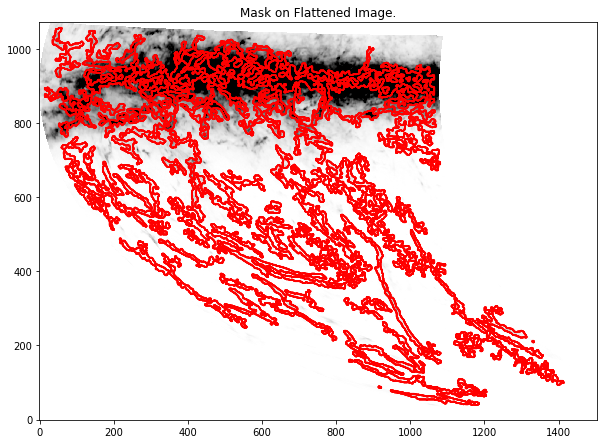

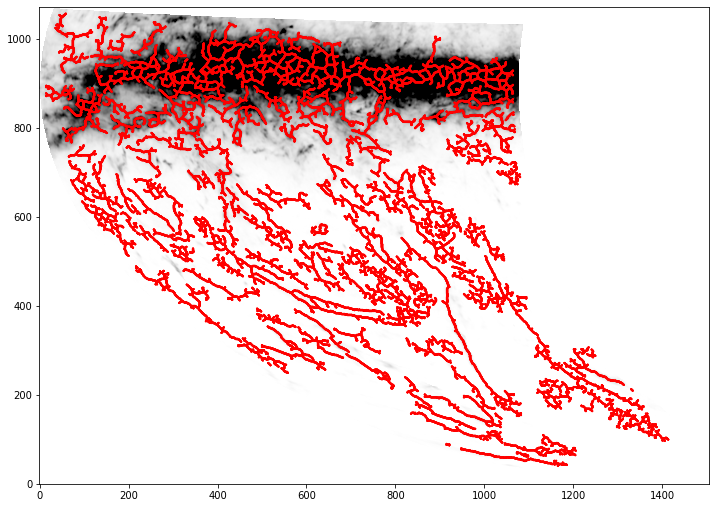

-68


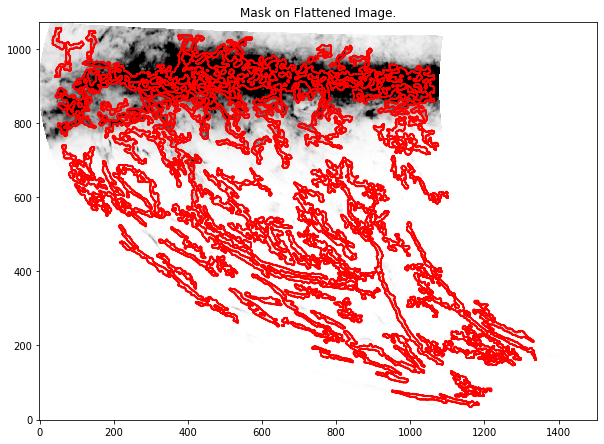

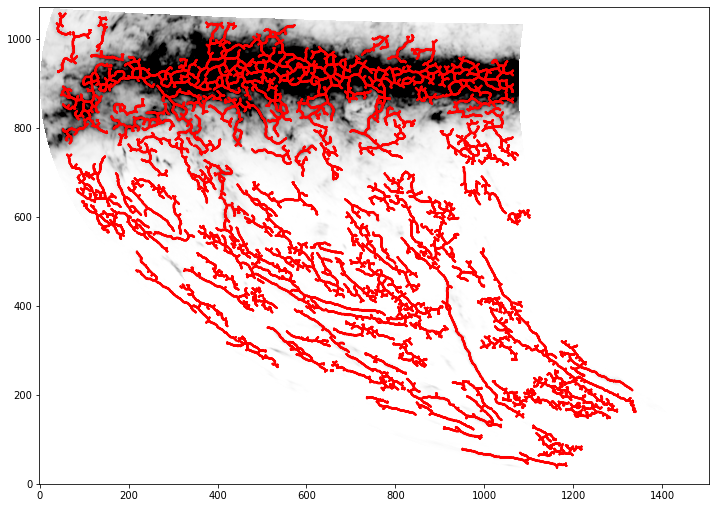

-66


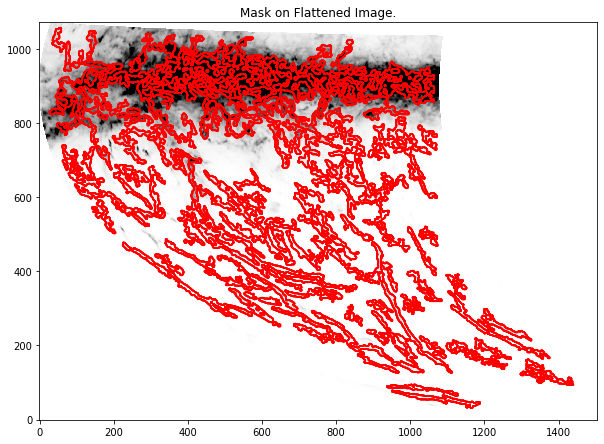

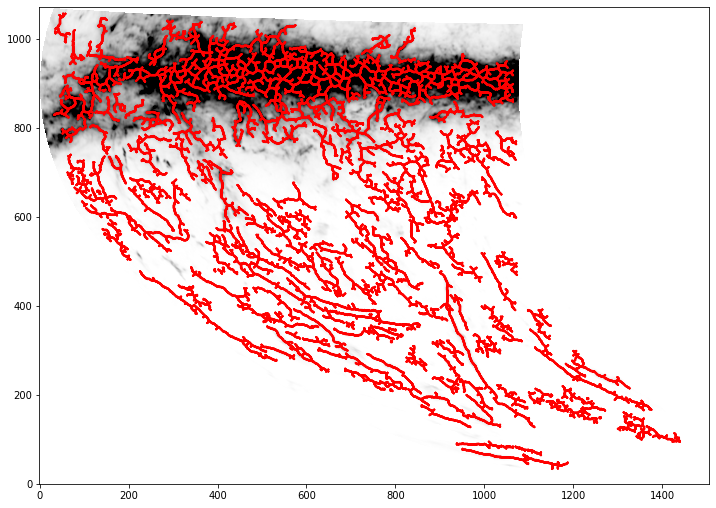

-64


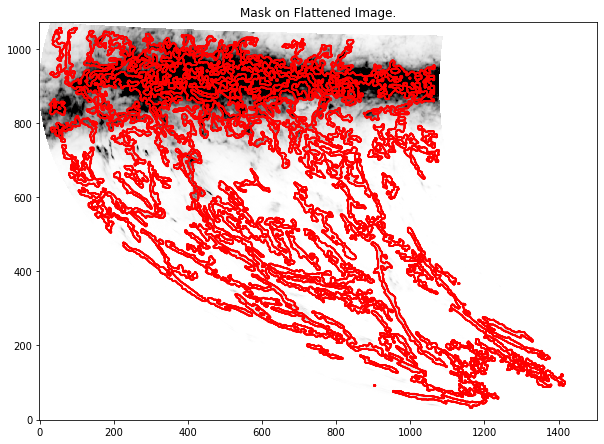

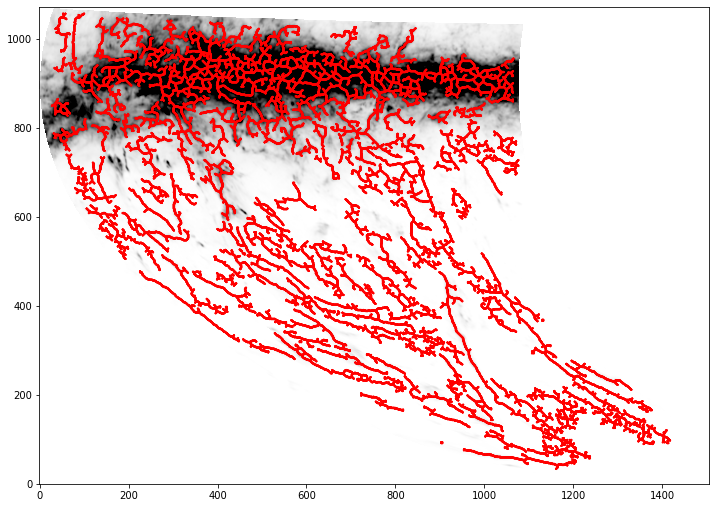

-62


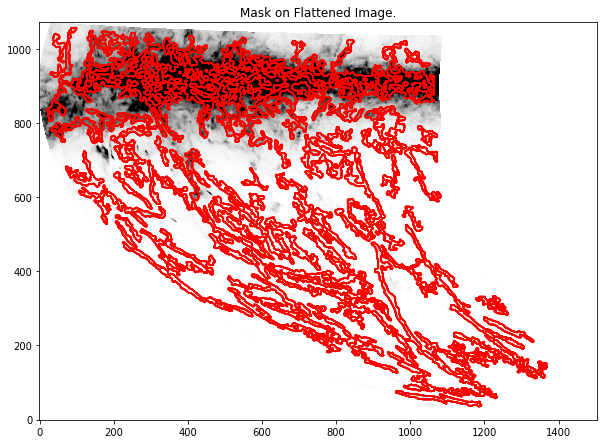

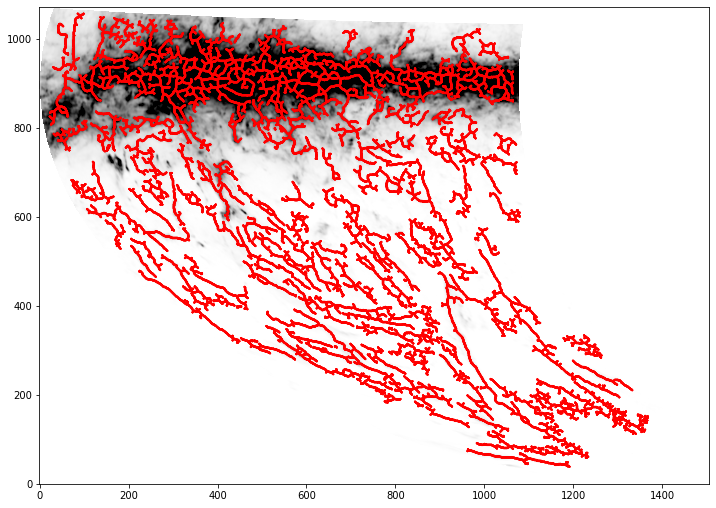

-60


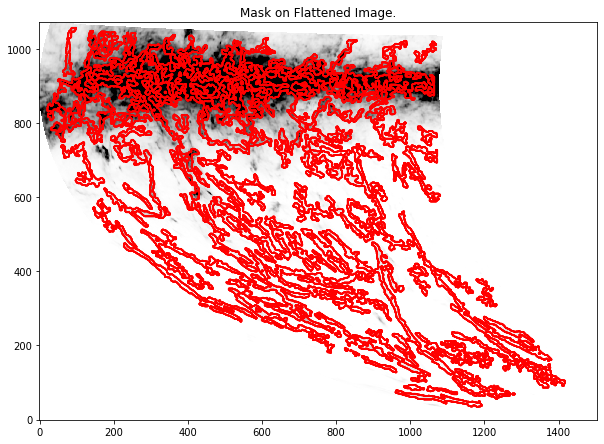

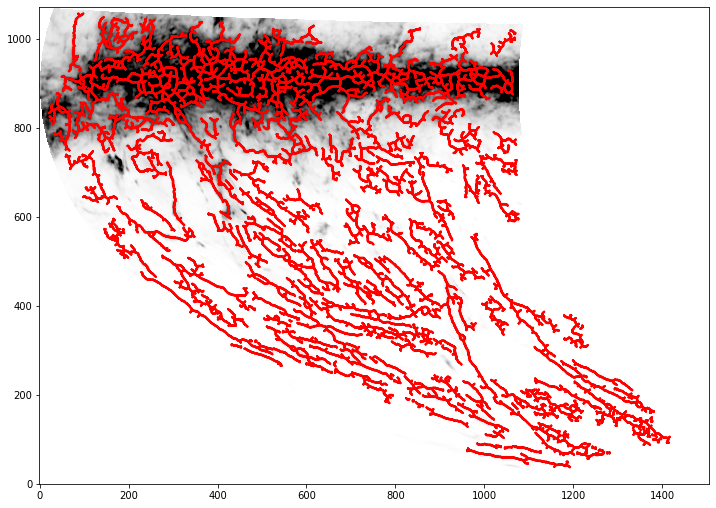

-58


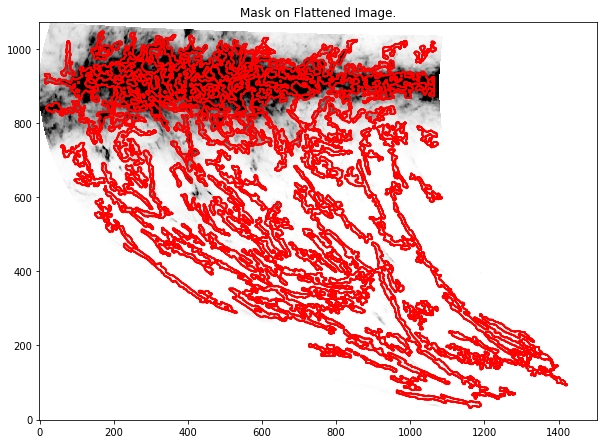

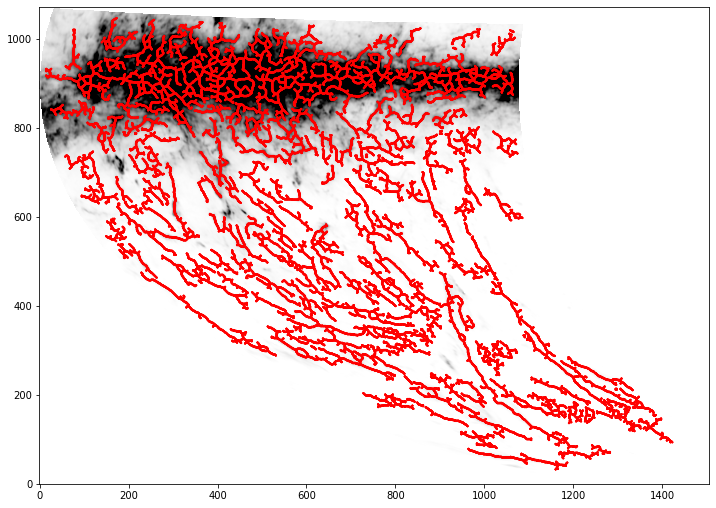

-56


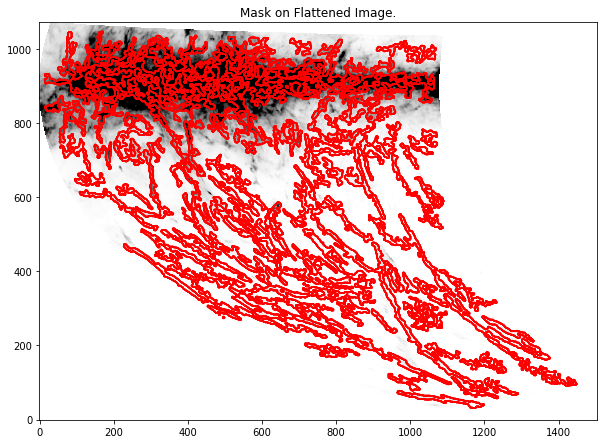

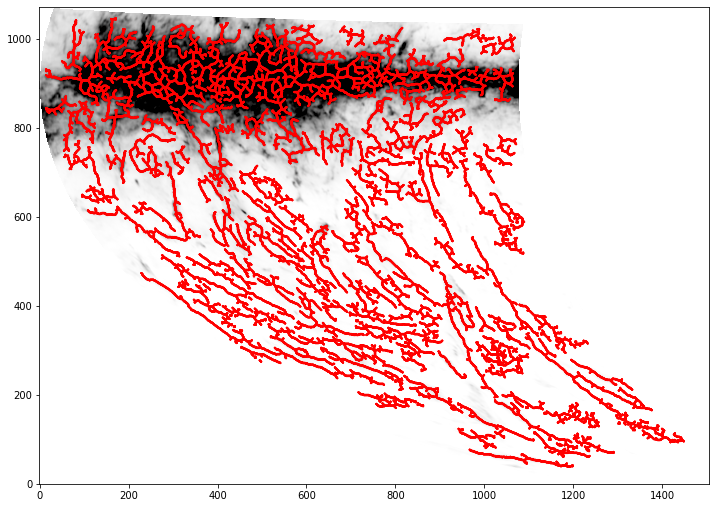

-54


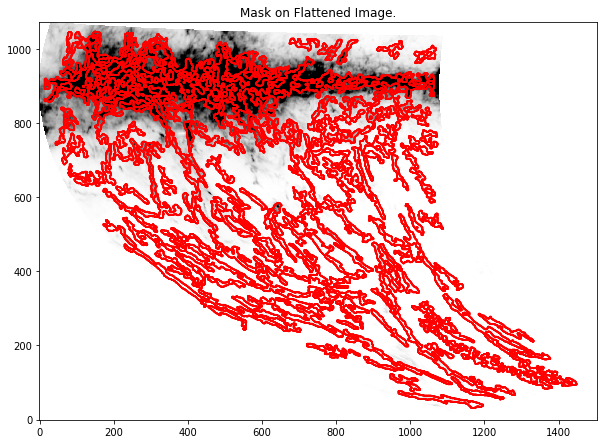

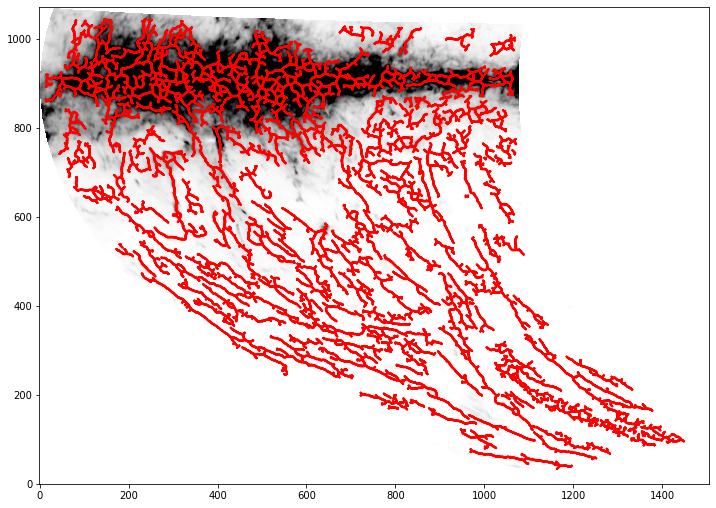

-52


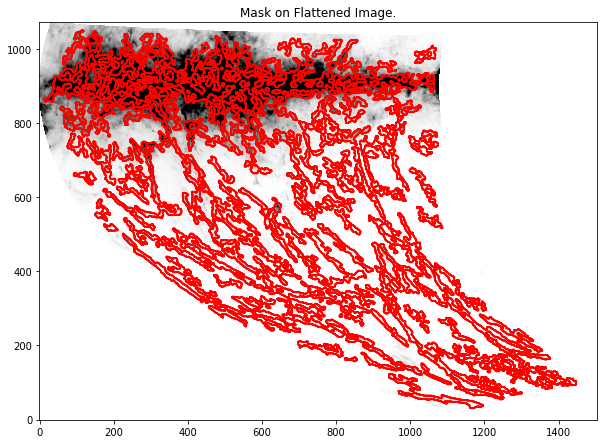

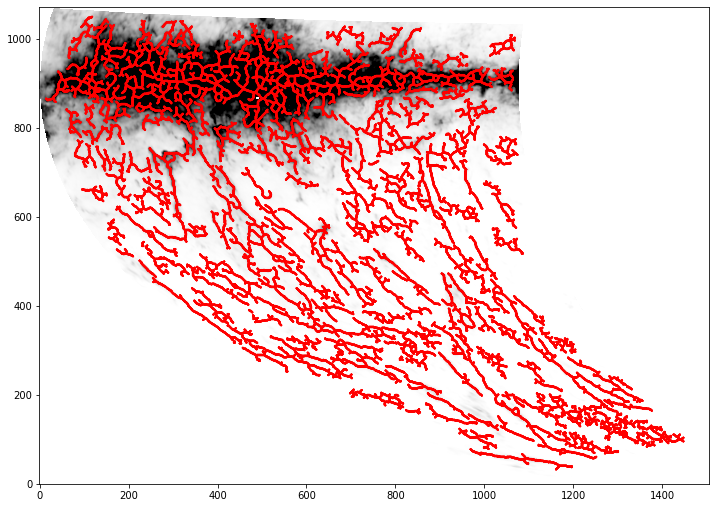

-50


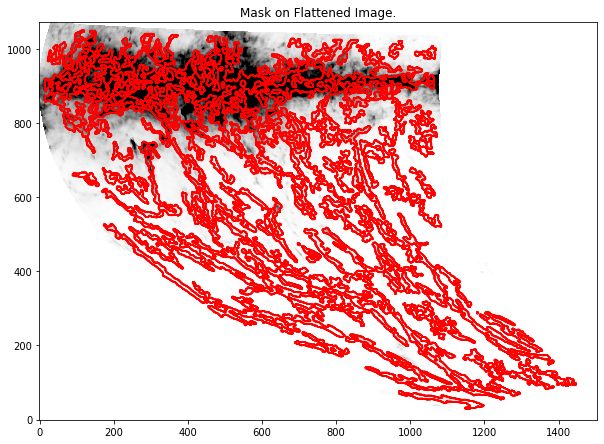

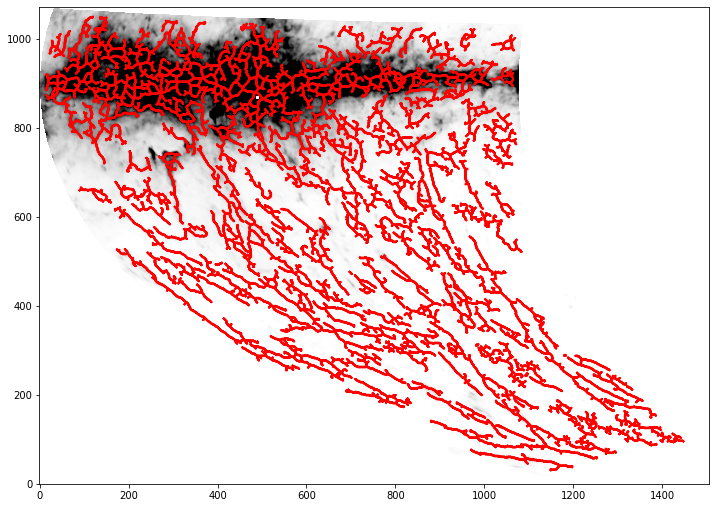

-48


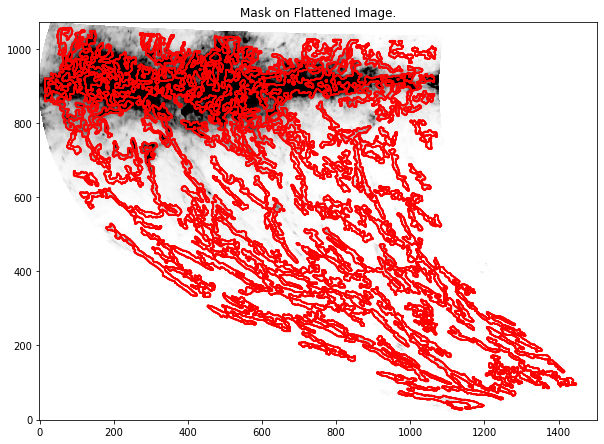

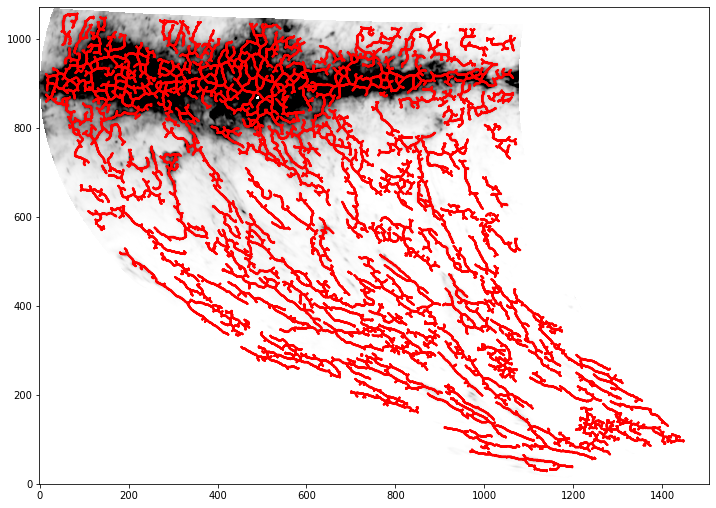

-46


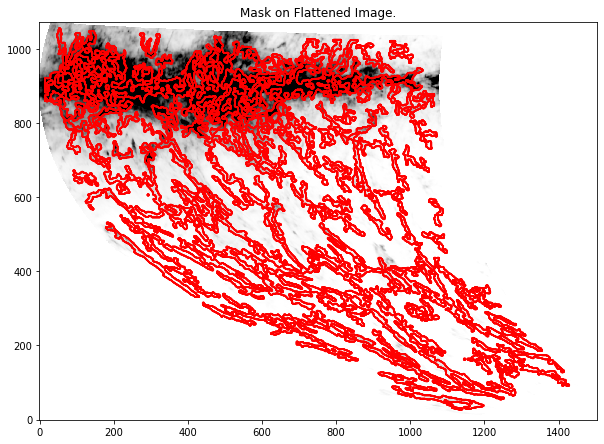

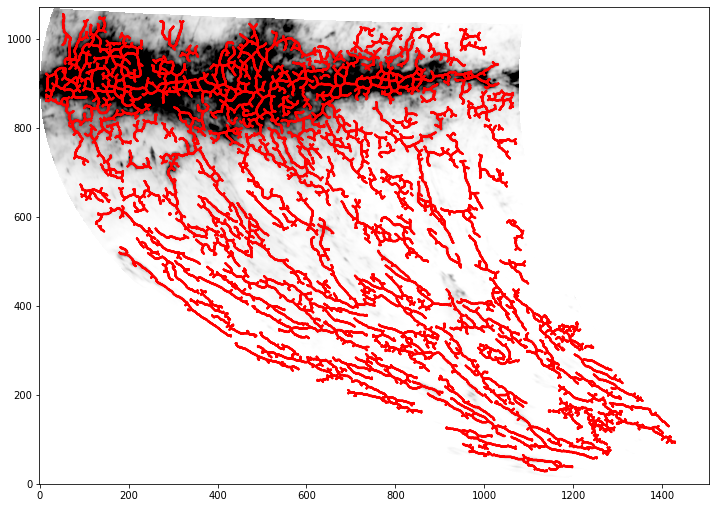

-44


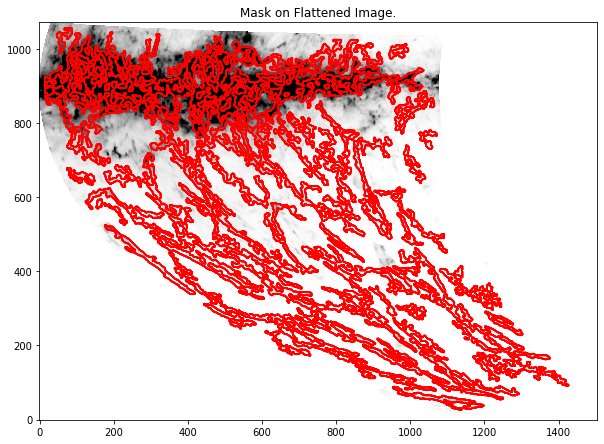

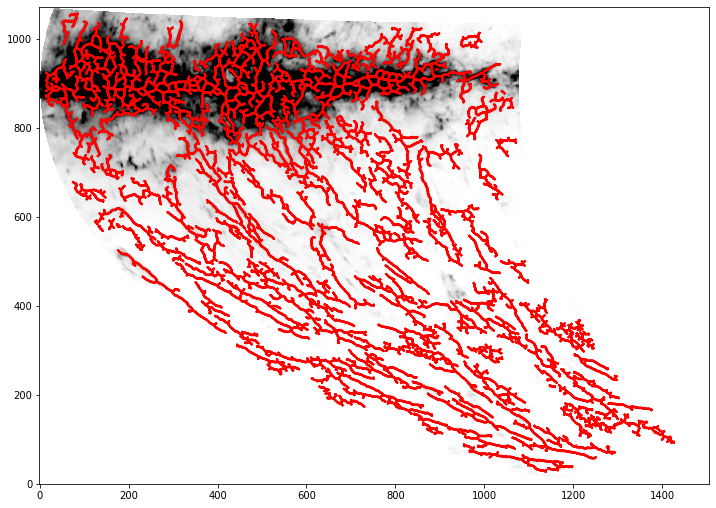

-42


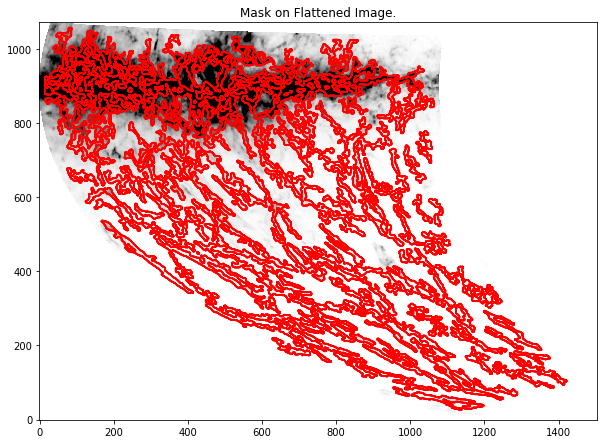

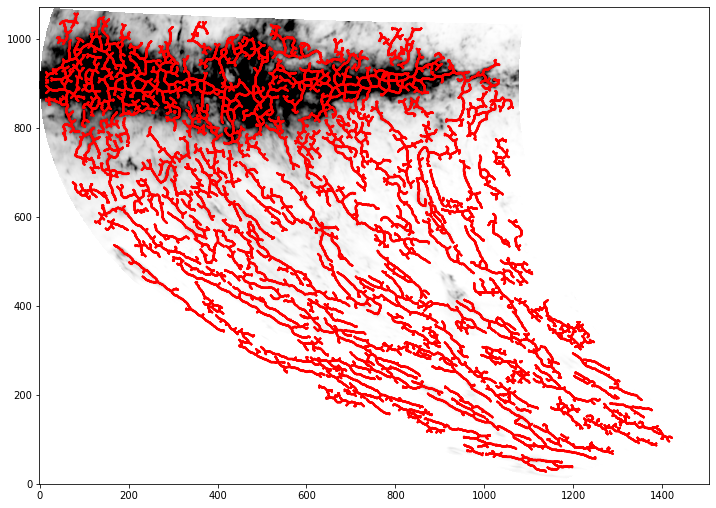

-40


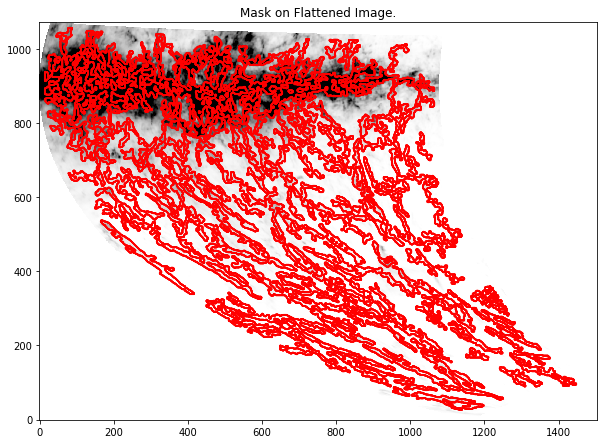

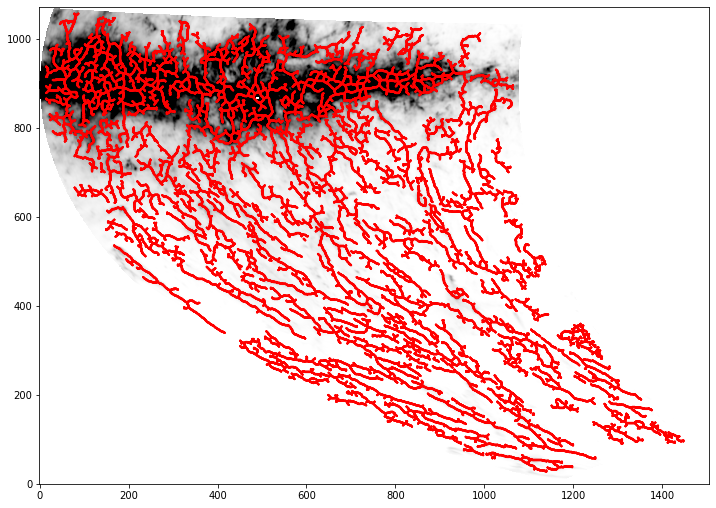

-38


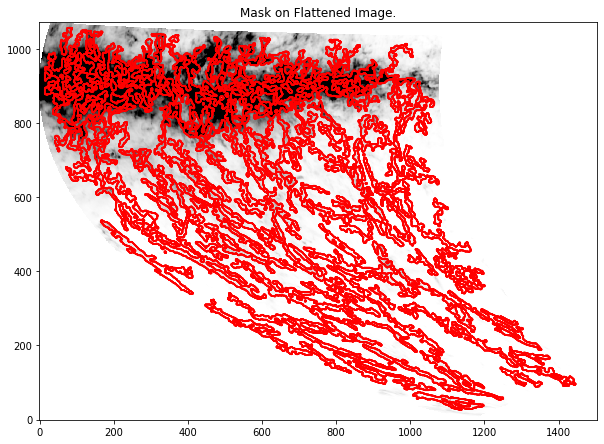

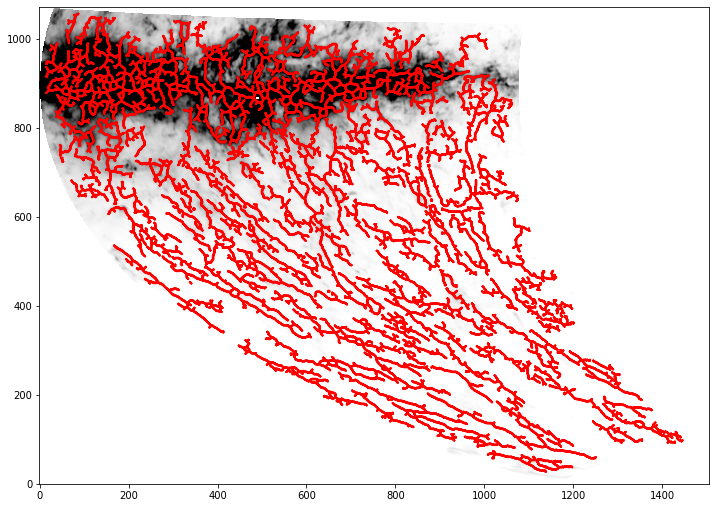

-36


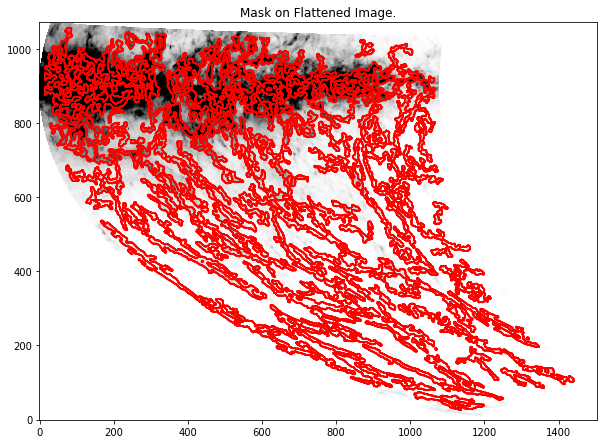

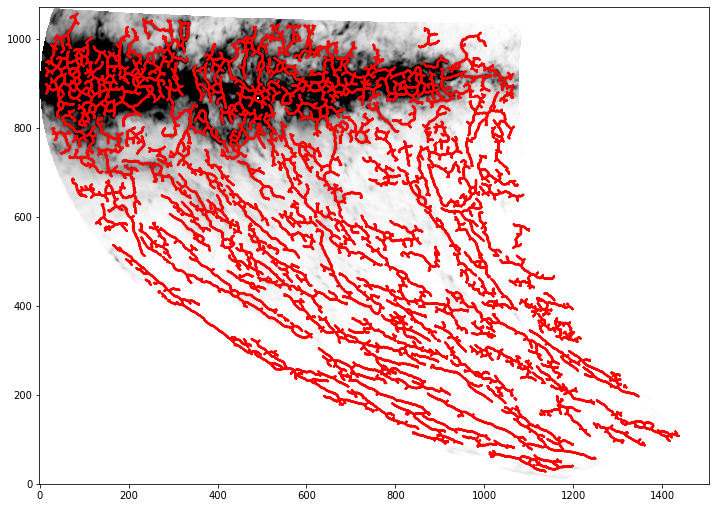

-34


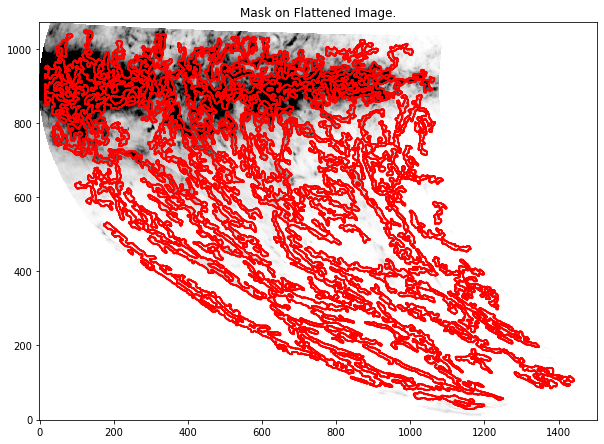

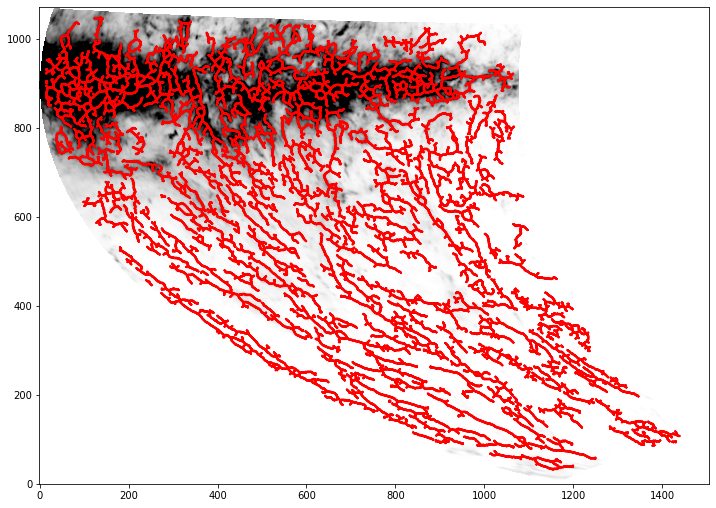

-32


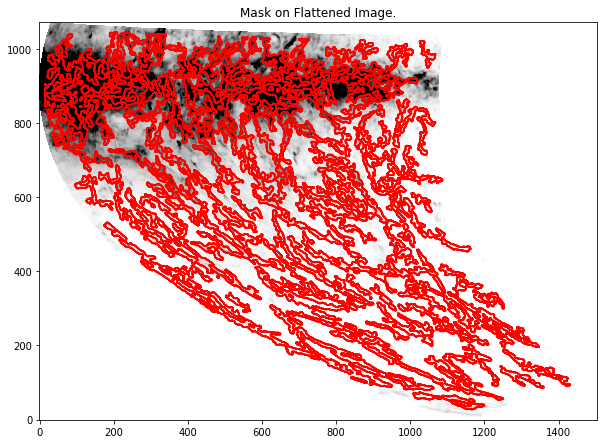

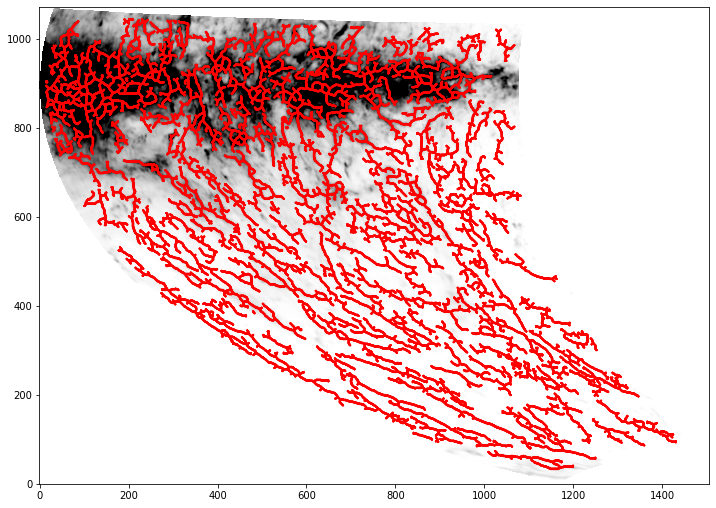

-30


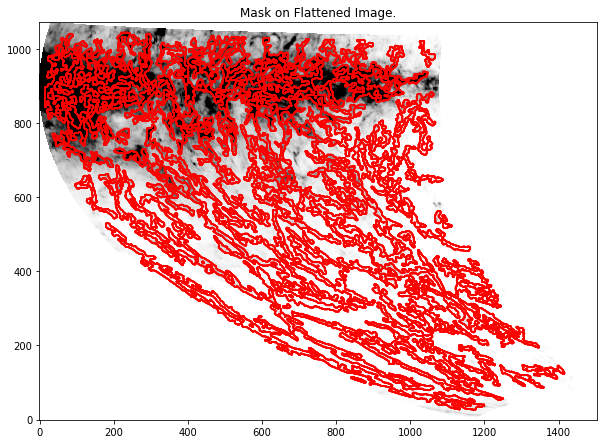

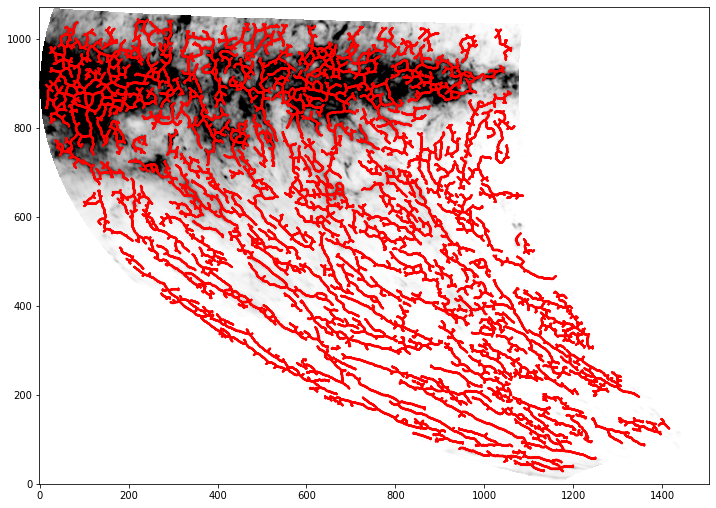

-28


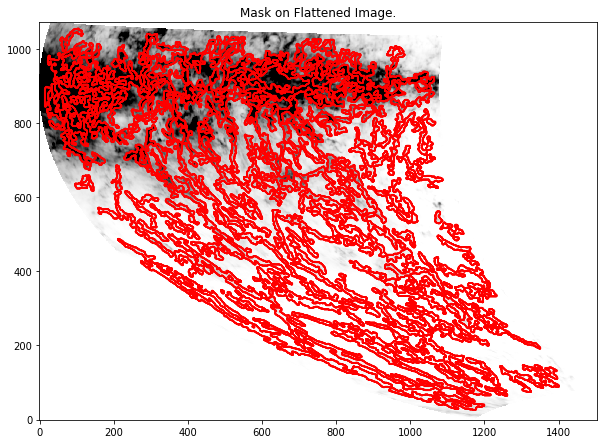

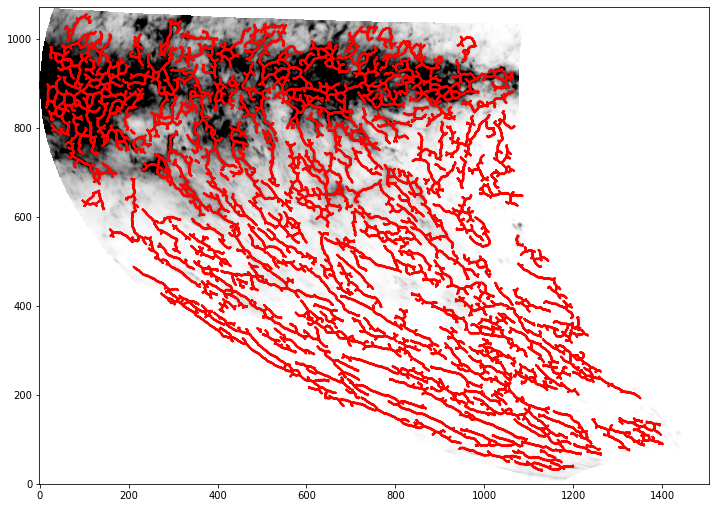

-26


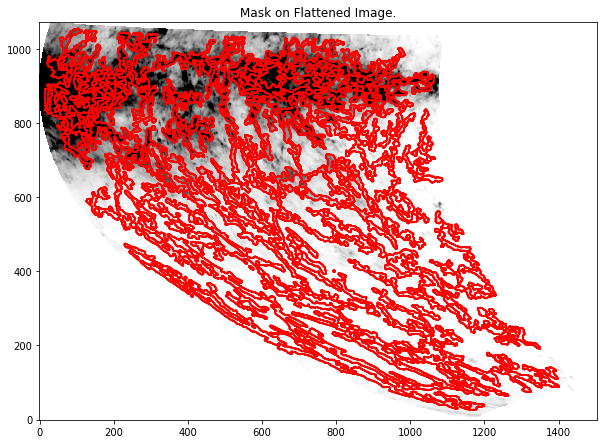

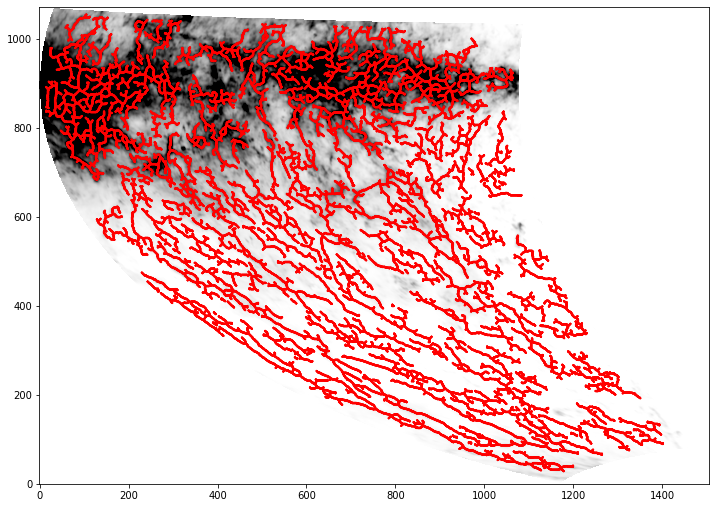

-24


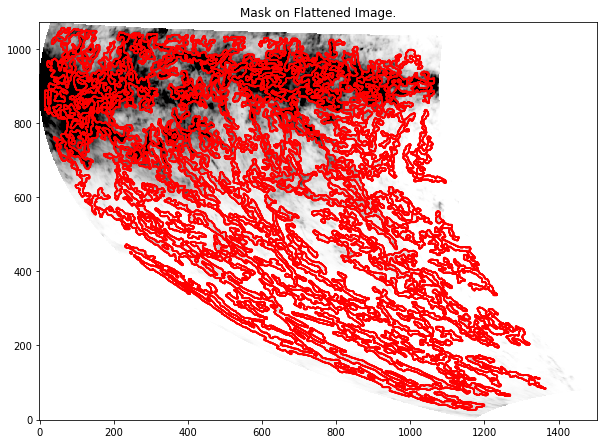

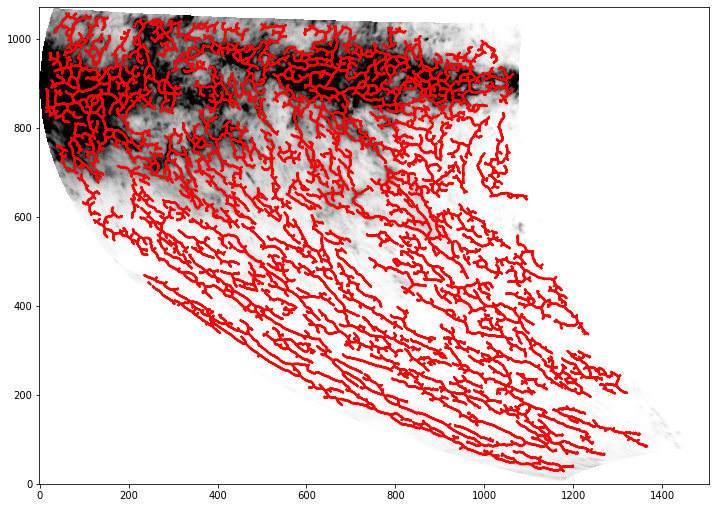

-22


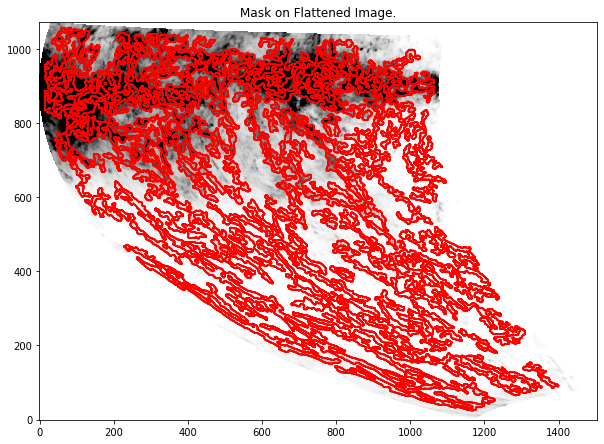

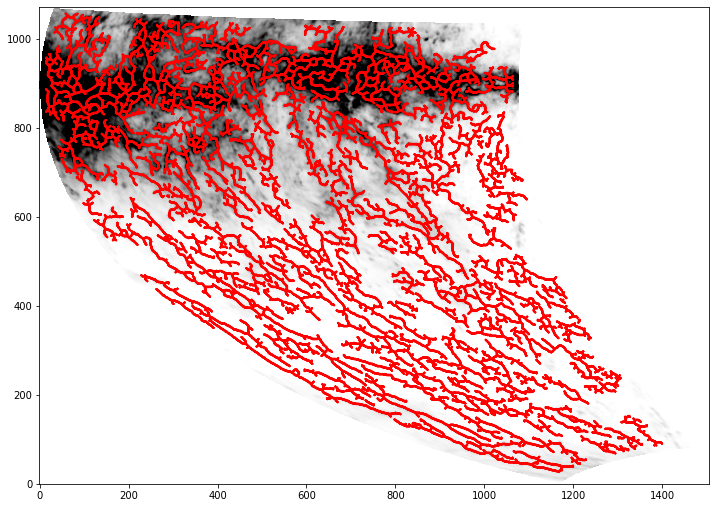

-20


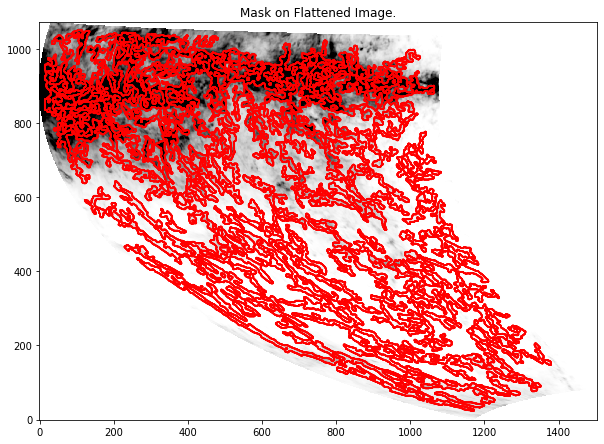

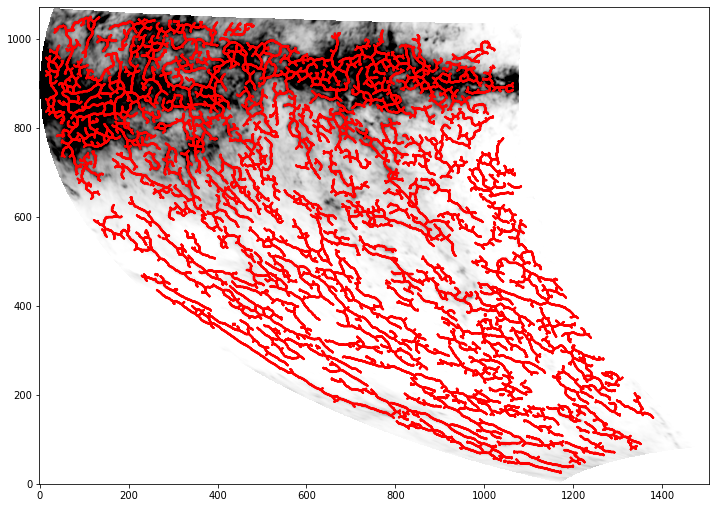

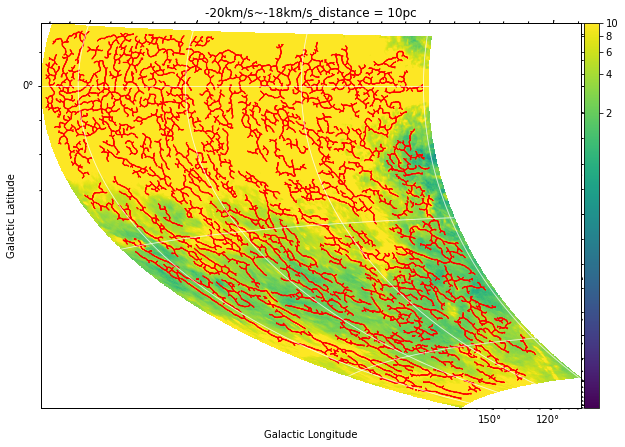

In [223]:
for v_start in range(-100,-18,2):
    print(v_start)
    make_integ_filament_array(hdu,v_start,v_start+2,10,0.2706,0.083333333,0.01,10)

-18


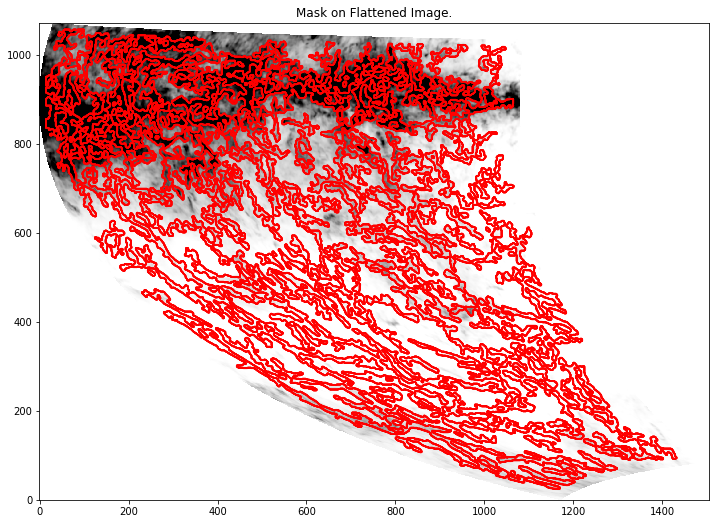

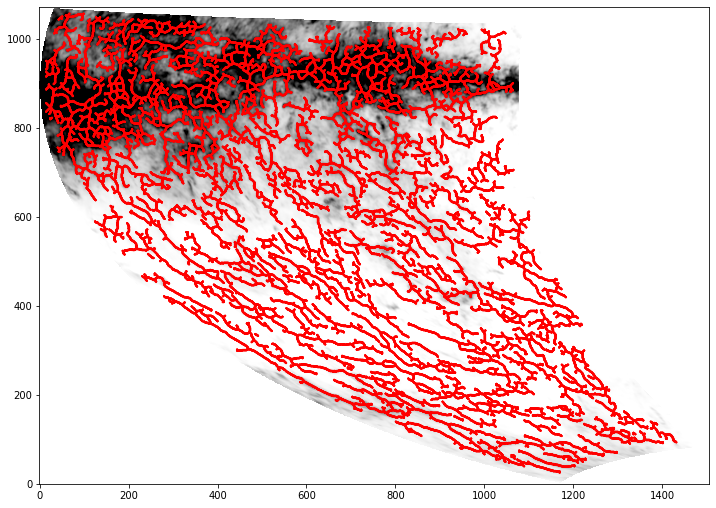

-16


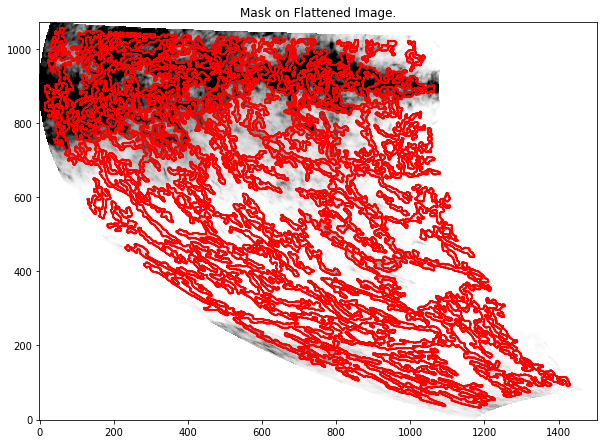

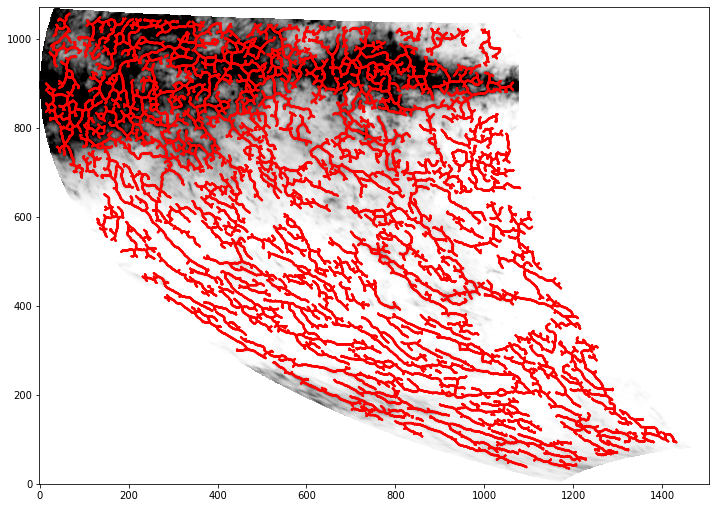

-14


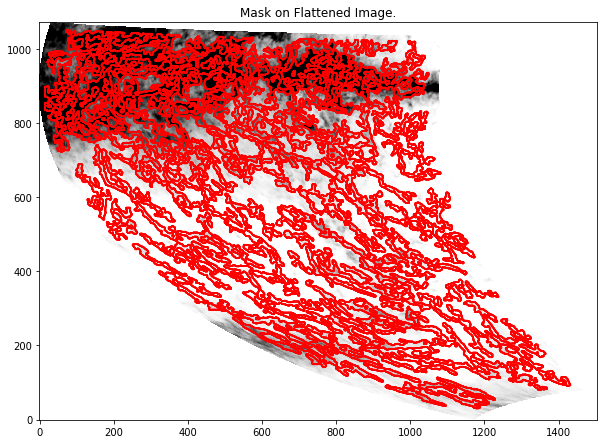

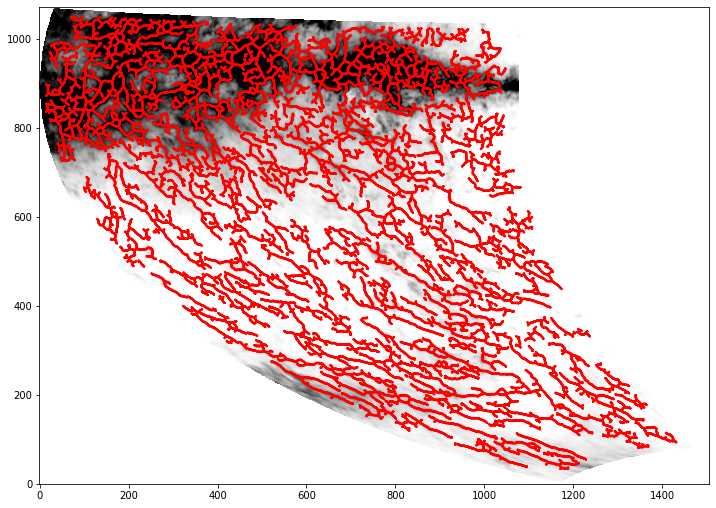

-12


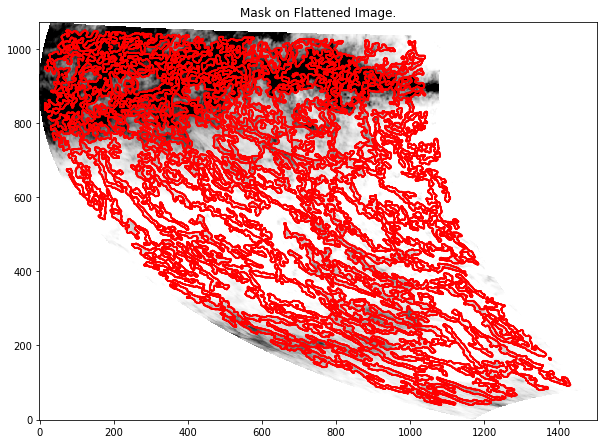

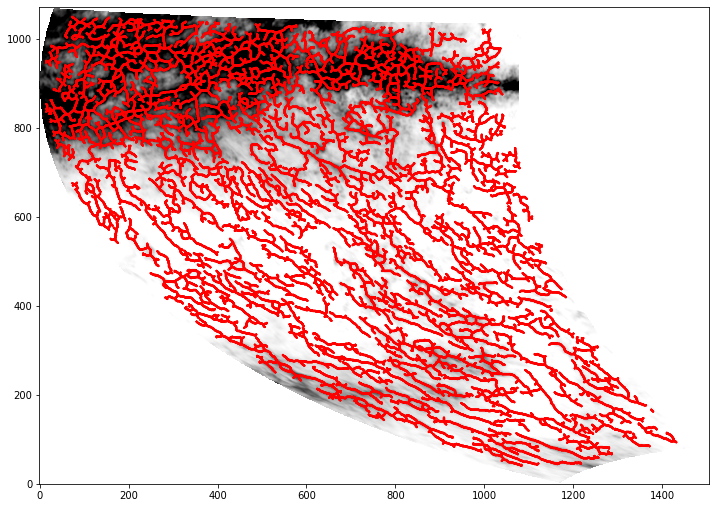

-10


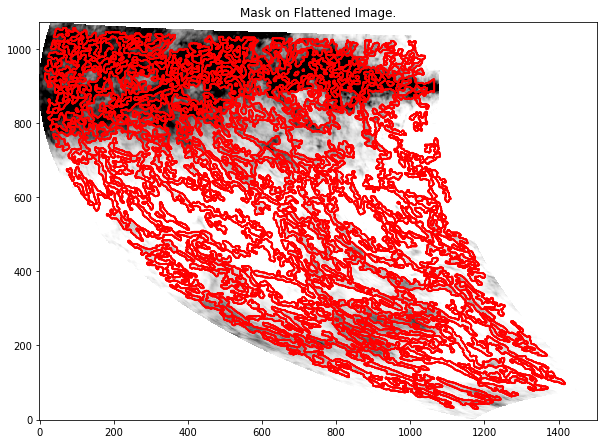

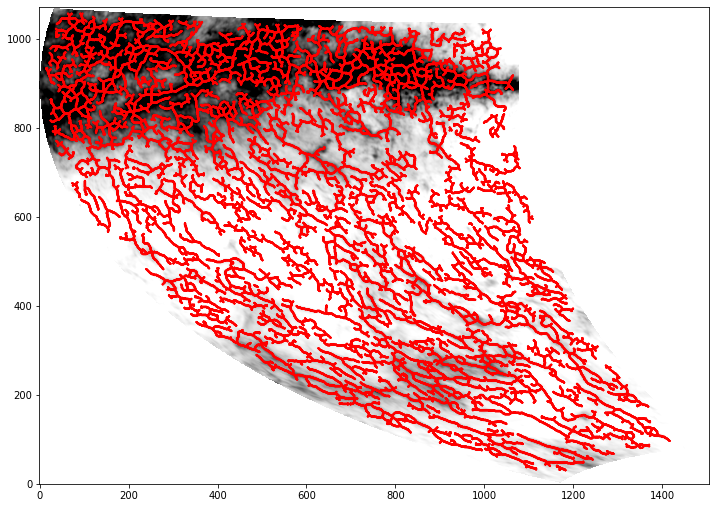

-8


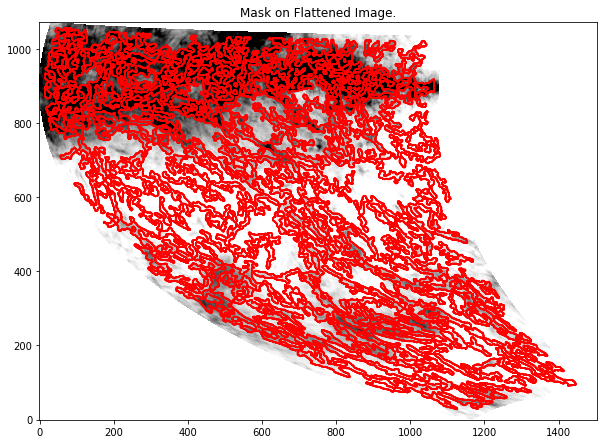

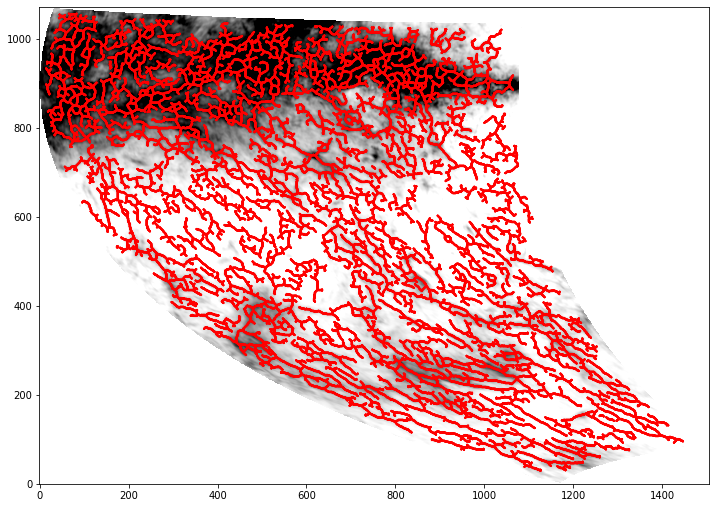

-6


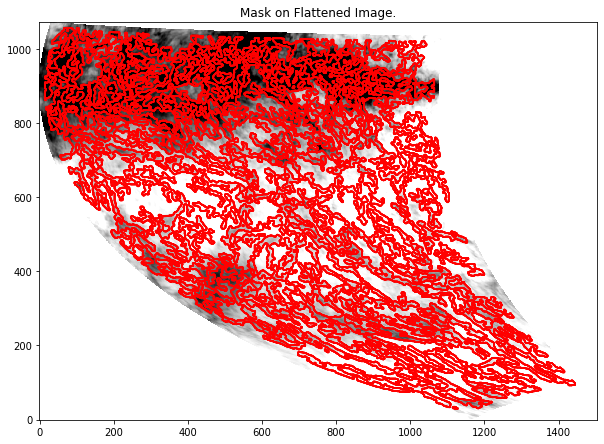

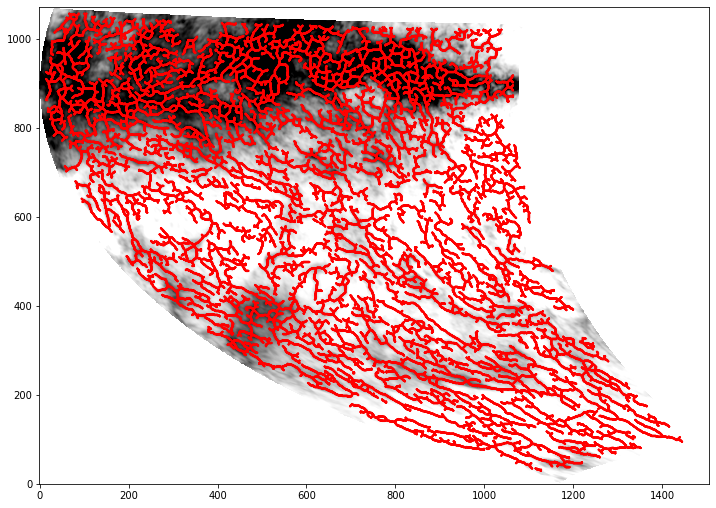

-4


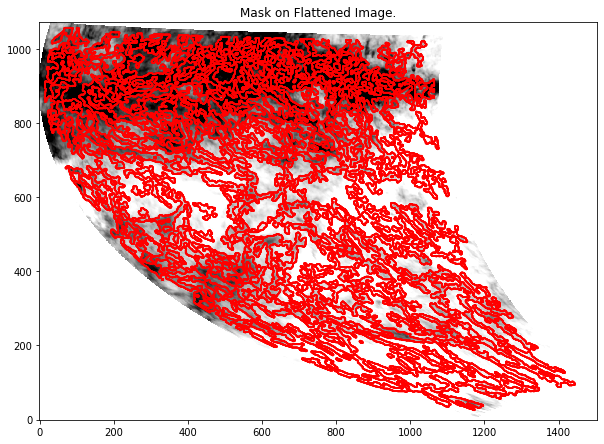

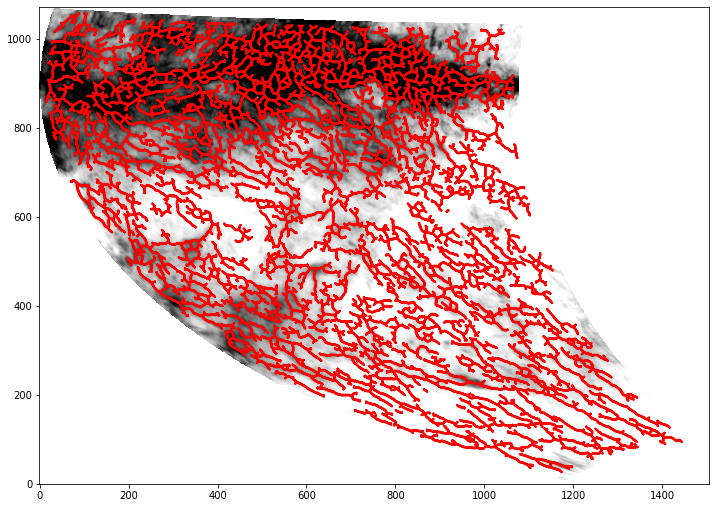

-2


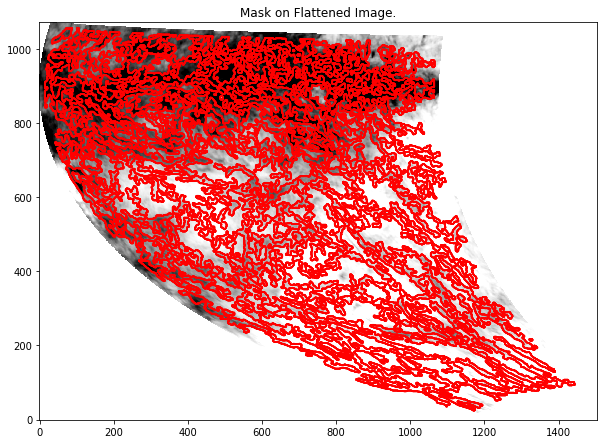

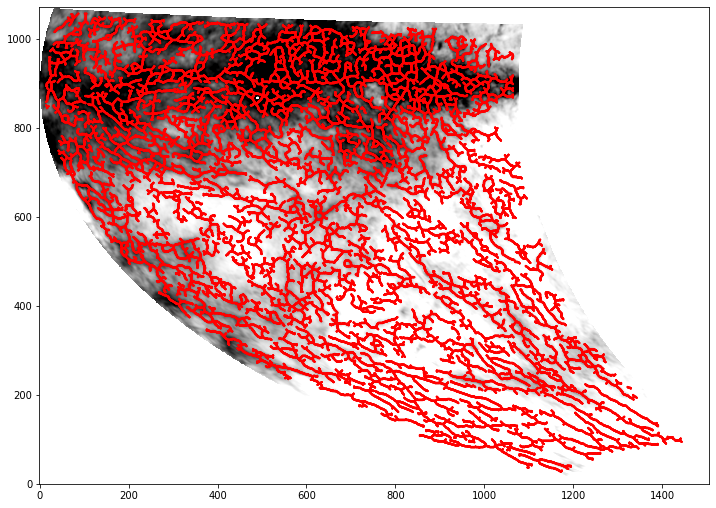

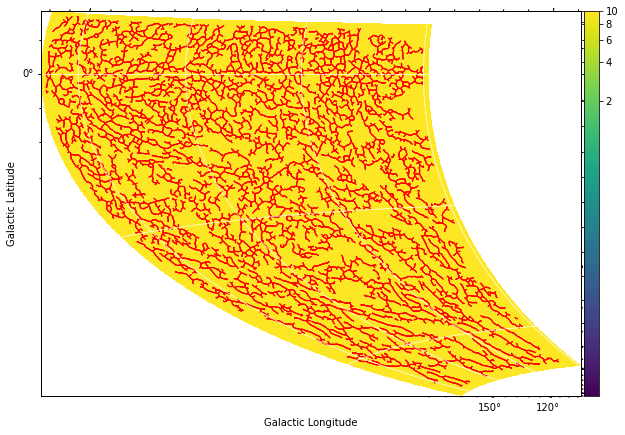

In [102]:
for v_start in range(-18,0,2):
    print(v_start)
    make_integ_filament_array(hdu,v_start,v_start+2,10,0.2706,0.083333333,0.01,10)

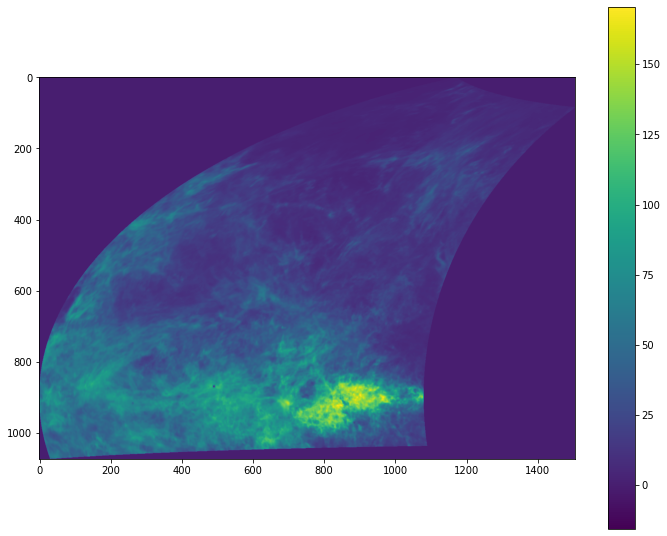

In [19]:
plt.imshow(integ_hdu.data)
plt.colorbar()

In [24]:
#hdr1 = copy.deepcopy(hdr0)
hdr1 = fits.PrimaryHDU().header

In [29]:
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -0.01
hdr1["CDELT2"] = 0.01
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
hdr1["BPA"] = integ_hdu.header["BPA"]
hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
hdr1["BMIN"] = integ_hdu.header["BMIN"]
hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]


In [30]:
#fil = FilFinder2D(fits.PrimaryHDU(arr, hdr0), ang_scale=0.1 * u.deg, distance=250 * u.pc, beamwidth=10 * u.arcsec)
#fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=250 * u.pc, beamwidth=2 * u.arcmin)
fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=250 * u.pc, beamwidth=hdr1["BMAJ"]* u.deg)
#fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=250 * u.pc, ang_scale=hdr1["CDELT2"]*u.deg, beamwidth=hdr1["BMAJ"]* u.deg)
#fil = FilFinder2D(integ_hdu, distance=250 * u.pc, ang_scale=0.1*u.deg, beamwidth=hdr1["BMAJ"]* u.deg)


In [31]:
fil.preprocess_image(flatten_percent=95)

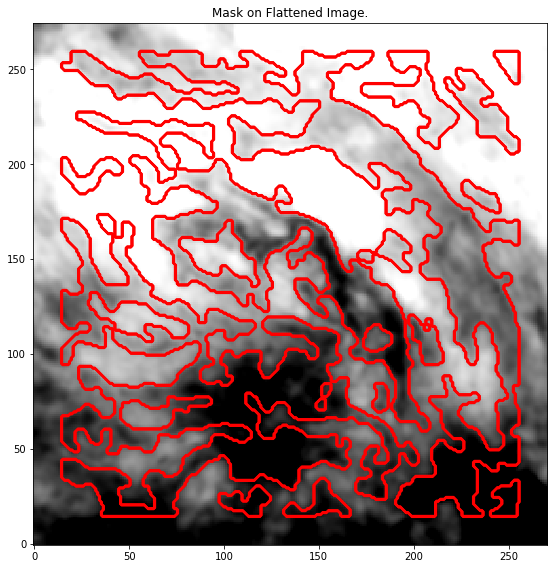

In [32]:
#fil.create_mask(verbose=True, adapt_thresh=1*u.pix)
#fil.create_mask(verbose=True, border_masking=False, size_thresh=400 * u.pix**2, glob_thresh=0.0267, adapt_thresh=1*u.pc, smooth_size=1*u.pix)
fil.create_mask(verbose=True)
#fil.create_mask(verbose=True, border_masking=False, size_thresh=4 * u.pix**2, glob_thresh=0.0267, adapt_thresh=1*u.pc)

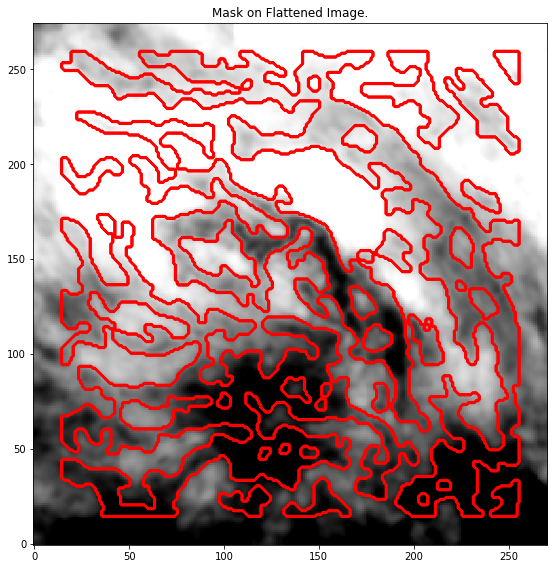

In [33]:
hdr1["CDELT1"] = -0.1
hdr1["CDELT2"] = 0.1

fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=25 * u.pc)#, beamwidth=hdr1["BMAJ"]* u.deg)
fil.preprocess_image(flatten_percent=95)
fil.create_mask(verbose=True)

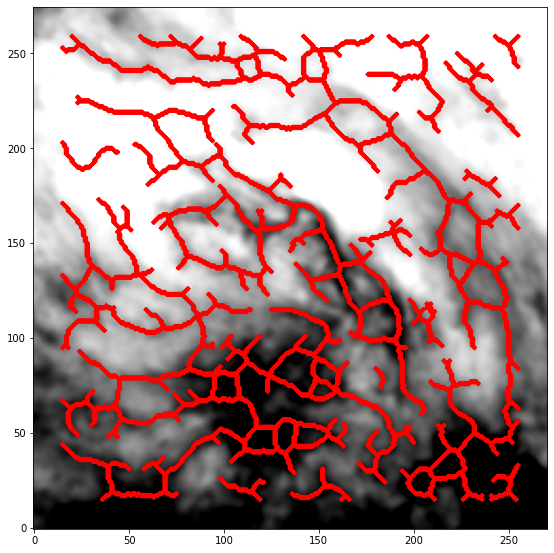

In [34]:
fil.medskel(verbose=True)

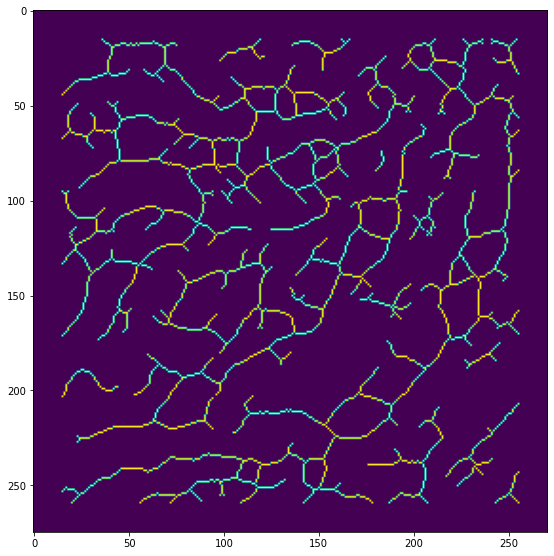

In [35]:
plt.imshow(fil.skeleton)

In [36]:
fil.skeleton

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [37]:
fil_hdu = fits.PrimaryHDU(fil.skeleton,integ_hdu.header)

KeyError: 'bool'

In [39]:
import aplpy

INFO: Auto-setting vmin to -4.236e+00 [aplpy.core]
INFO: Auto-setting vmax to  1.098e+02 [aplpy.core]


NameError: name 'fil_hdu' is not defined

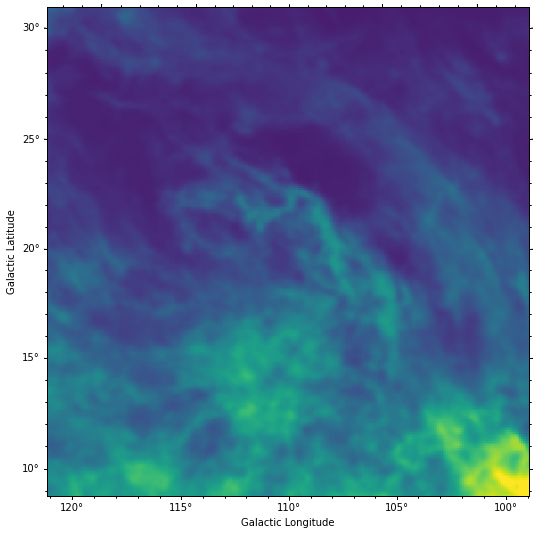

In [40]:
fig = aplpy.FITSFigure(integ_hdu)
fig.show_colorscale()
fig.show_contour(fil_hdu,colors="r",linewidths=0.5)

In [41]:
fil.analyze_skeletons()

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")


In [42]:
fil.filaments[0].position()

[<Quantity 76. pix>, <Quantity 86. pix>]

In [43]:
fil.exec_rht()

In [44]:
fil.lengths()

<Quantity [358.0904038 ,  29.38477631,  36.21320344, 493.45793616,
            28.3137085 , 286.56349186,  32.21320344,  35.21320344,
            22.55634919,  44.28427125,  61.91168825,  74.66904756,
            22.14213562] pix>

In [45]:
fil.branch_properties.keys()

dict_keys(['length', 'intensity', 'pixels', 'number'])

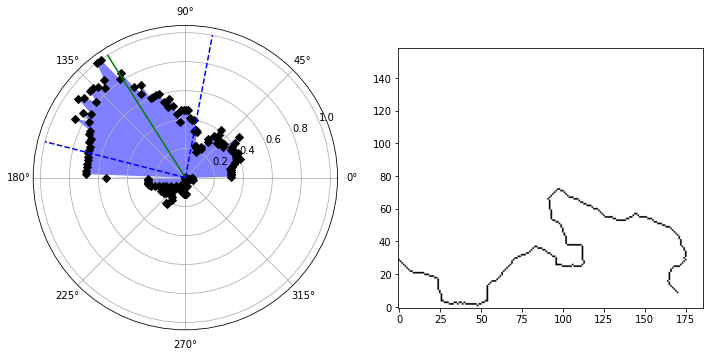

In [46]:
fil.filaments[0].plot_rht_distrib()

In [337]:
cdelt = 0.083333333
bmaj = 0.2706
w = WCS(hdu)
integ_hdu = make_new_hdu_integ(hdu, -50, -48, w)
integ_hdu.data[integ_hdu.data<=0.01]=np.nan
hdr1 = fits.PrimaryHDU().header
hdr1["BITPIX"] = integ_hdu.header["BITPIX"]
hdr1["NAXIS"] = integ_hdu.header["NAXIS"]
hdr1["NAXIS1"] = integ_hdu.header["NAXIS1"]
hdr1["NAXIS2"] = integ_hdu.header["NAXIS2"]
# hdr1["CDELT1"] = integ_hdu.header["CDELT1"]
# hdr1["CDELT2"] = integ_hdu.header["CDELT2"]
hdr1["CDELT1"] = -cdelt
hdr1["CDELT2"] = cdelt
hdr1["CRVAL1"] = integ_hdu.header["CRVAL1"]
hdr1["CRVAL2"] = integ_hdu.header["CRVAL2"]
hdr1["CRPIX1"] = integ_hdu.header["CRPIX1"]
hdr1["CRPIX2"] = integ_hdu.header["CRPIX2"]
hdr1["CTYPE1"] = integ_hdu.header["CTYPE1"]
hdr1["CTYPE2"] = integ_hdu.header["CTYPE2"]
hdr1["CUNIT1"] = integ_hdu.header["CUNIT1"]
hdr1["CUNIT2"] = integ_hdu.header["CUNIT2"]
#     hdr1["BPA"] = integ_hdu.header["BPA"]
#     hdr1["BMAJ"] = integ_hdu.header["BMAJ"]
#     hdr1["BMIN"] = integ_hdu.header["BMIN"]
#     hdr1["LONPOLE"] = integ_hdu.header["LONPOLE"]
#     hdr1["LATPOLE"] = integ_hdu.header["LATPOLE"]



fil = FilFinder2D(fits.PrimaryHDU(integ_hdu.data, hdr1), distance=10 * u.pc, beamwidth=bmaj* u.deg)

fil.preprocess_image(flatten_percent=95)
fil.create_mask(verbose=True)
fil.medskel(verbose=True)
fil_skeleton= fil.skeleton
fil_skeleton = fil_skeleton.astype("int")

KeyError: "Keyword 'CUNIT1' not found."

In [316]:
fil.analyze_skeletons()
fil.exec_rht()

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")


In [317]:
fil.orientation

<Quantity [ 1.39632554,  1.07267769,  1.4166724 ,  1.46879699,  1.2792941 ,
            1.39598305,  1.25537888,  1.14824681,  1.12859174,  0.99178834,
            0.51097802,  1.09559039,  1.0127144 ,  1.29229153,  1.01213809,
            1.01955446,  1.32204745,  1.07428423,  0.74618772,  1.27267415,
            0.79291966,  1.09119603,  1.04389719,  0.55899148,  1.10313449,
            1.20518061,  1.39900934,  1.05977742,  0.68934933, -1.44312844,
            1.50932225,  0.69649407,  1.00936614,  0.88419018,  0.73916345,
            1.17461226,  0.46366031,  1.06507835,  0.39968673,  1.16885161,
            1.23907457,  1.08724524,  1.23578124,  0.98710536,  0.7060629 ,
            0.73657185,  0.85109923,  0.94405205,  0.43701687,  1.03368832,
            0.71262863,  0.58193477,  0.90392206,  0.98980076,  0.80078423,
            0.37997484,  0.75036477,  0.58651046,  0.79207258,  0.64548425,
            0.37996503,  0.49294709,  0.78153396,  1.20902965,  0.96669852,
            

In [318]:
ori = np.array(np.rad2deg(fil.orientation))

In [319]:
ori

array([ 80.00356046,  61.4599046 ,  81.16934949,  84.15586863,
        73.29815252,  79.98393683,  71.92791154,  65.78969578,
        64.66354344,  56.82528577,  29.27688377,  62.77270532,
        58.02426091,  74.0428504 ,  57.99124081,  58.41616775,
        75.74773926,  61.55195236,  42.75340733,  72.91885774,
        45.43095009,  62.52092718,  59.810903  ,  32.02785264,
        63.20495034,  69.05176237,  80.15733058,  60.7207735 ,
        39.49680698, -82.68516899,  86.47779459,  39.90617092,
        57.83242007,  50.66036538,  42.35094607,  67.30032506,
        26.56577882,  61.02449458,  22.90036261,  66.97026411,
        70.99374309,  62.29456361,  70.80504967,  56.55697084,
        40.45442428,  42.20245836,  48.76439391,  54.09019825,
        25.03922196,  59.22597789,  40.83061285,  33.34240644,
        51.79091929,  56.71140596,  45.88155673,  21.7709549 ,
        42.99273461,  33.6045742 ,  45.3824158 ,  36.98352328,
        21.77039276,  28.2437879 ,  44.77859749,  69.27

(array([10.,  2.,  1.,  7.,  2.,  2., 26., 27., 34., 17.]),
 array([-88.61206332, -70.79074503, -52.96942675, -35.14810846,
        -17.32679017,   0.49452811,  18.3158464 ,  36.13716468,
         53.95848297,  71.77980126,  89.60111954]),
 <BarContainer object of 10 artists>)

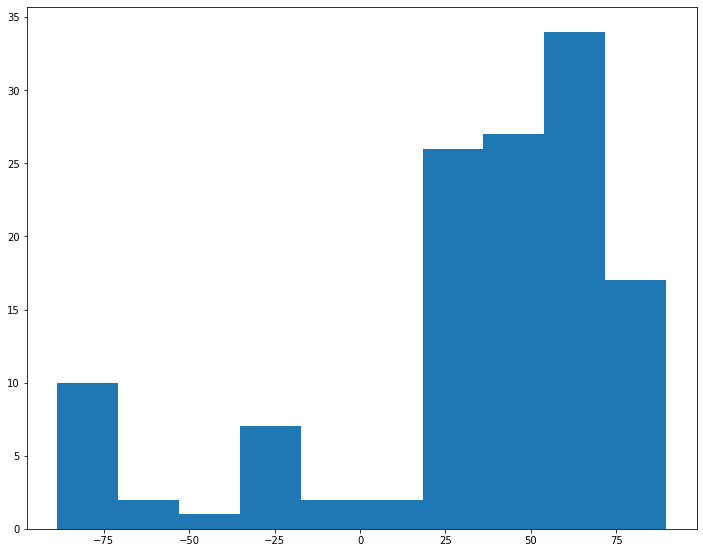

In [320]:
plt.hist(ori)

In [118]:
fil0 = fil.filaments[0]
fil1 = fil.filaments[1]
fil2 = fil.filaments[2]
fil3 = fil.filaments[3]

In [322]:
fil1.skeleton()


array([[False, False, False, ..., False, False,  True],
       [False, False, False, ...,  True,  True, False],
       [False, False, False, ..., False, False, False],
       ...,
       [ True, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

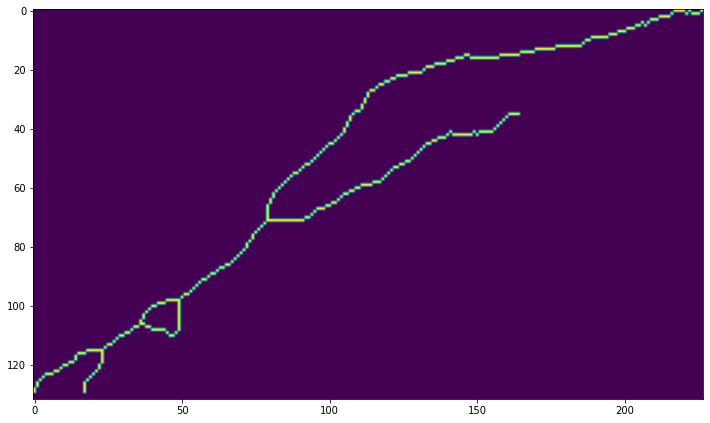

In [323]:
plt.imshow(fil1.skeleton())

In [324]:
fil0.position()

[<Quantity 55. pix>, <Quantity 1092. pix>]

In [335]:
w.wcs_pix2world([55,1092],0)

RuntimeError: Input array must be 2-dimensional, where the second dimension >= 3

In [119]:
fil0.position()

[<Quantity 46. pix>, <Quantity 1162. pix>]

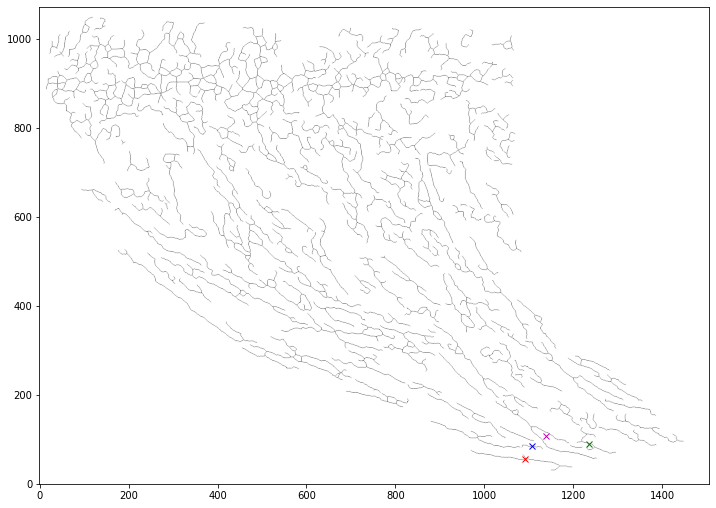

In [187]:
plt.imshow(fil.skeleton,origin="lower",cmap="Greys")
plt.plot(fil0.position()[1],fil0.position()[0],color="red",marker="x")
plt.plot(fil1.position()[1],fil1.position()[0],color="m",marker="x")
plt.plot(fil2.position()[1],fil2.position()[0],color="g",marker="x")
plt.plot(fil3.position()[1],fil3.position()[0],color="b",marker="x")

In [188]:
np.rad2deg(fil0.orientation),np.rad2deg(fil1.orientation),np.rad2deg(fil2.orientation),np.rad2deg(fil3.orientation),

(<Quantity 79.94034688 deg>,
 <Quantity 61.56166726 deg>,
 <Quantity 74.52842419 deg>,
 <Quantity 84.11984897 deg>)

In [196]:
ypos = np.array([f.position()[0].value for f in fil.filaments])

In [197]:
ypos

array([  55. ,  106. ,   90. ,   84. ,  106. ,   82. ,  112. ,  125. ,
        111. ,  144. ,  143. ,  164. ,  181. ,  173. ,  238. ,  189. ,
        192.5,  242. ,  288. ,  215. ,  241. ,  219. ,  240.5,  272. ,
        272. ,  283. ,  245. ,  310. ,  262.5,  295. ,  342. ,  365. ,
        329. ,  391.5,  458. ,  341. ,  405. ,  352. ,  355. ,  384. ,
        372. ,  444. ,  386. ,  443. ,  457. ,  543. ,  456. ,  434. ,
        525. ,  443. ,  478. ,  490. ,  521. ,  553. ,  517. ,  519. ,
        534.5,  518. ,  559. ,  579. ,  660. ,  635. ,  579. ,  562. ,
        592. ,  608. ,  616. ,  707. ,  613. ,  600. ,  612. ,  644. ,
        612.5,  633.5,  680. ,  624.5,  673. ,  627. ,  655. ,  651. ,
        638.5,  655. ,  666. ,  669. ,  900. ,  705.5,  696. ,  690. ,
        700. ,  714. ,  729. ,  743. ,  721. ,  778.5,  748. ,  743. ,
        750. ,  762. ,  813. ,  771. ,  776.5,  791. ,  767. ,  833. ,
        798. ,  801. ,  812. ,  823. ,  818. ,  820.5,  841.5,  863. ,
      

In [203]:
fil.analyze_skeletons()
fil.exec_rht()
ori = np.array(np.rad2deg(fil.orientation))
ori2 = ori
ori2 = ori2[ypos<=800]

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:326: UserWarning: Graph pruning reached max iterations.
  warnings.warn("Graph pruning reached max iterations.")


IndexError: boolean index did not match indexed array along dimension 0; dimension is 127 but corresponding boolean dimension is 128

(array([ 2.,  2.,  1.,  0.,  0.,  1.,  0.,  0.,  1.,  2.,  9., 13., 18.,
        18., 18., 12.,  5.]),
 array([-90.        , -79.41176471, -68.82352941, -58.23529412,
        -47.64705882, -37.05882353, -26.47058824, -15.88235294,
         -5.29411765,   5.29411765,  15.88235294,  26.47058824,
         37.05882353,  47.64705882,  58.23529412,  68.82352941,
         79.41176471,  90.        ]),
 <BarContainer object of 17 artists>)

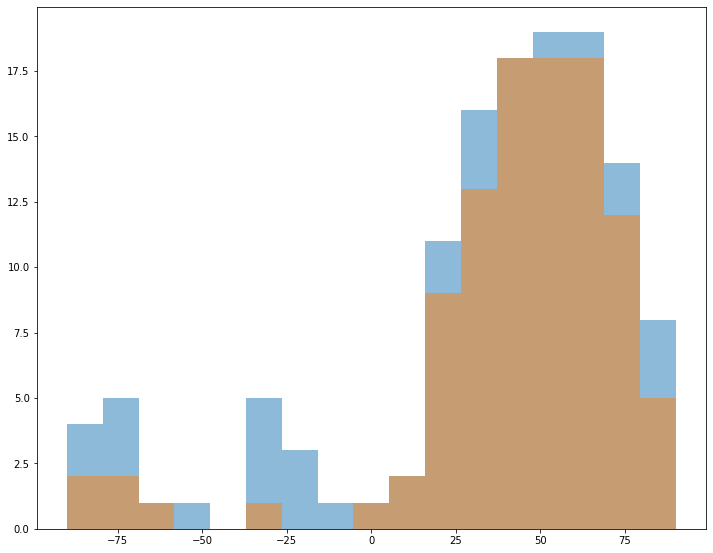

In [202]:
plt.hist(ori,alpha=0.5,bins=np.linspace(-90,90,num=18))
plt.hist(ori2,alpha=0.5,bins=np.linspace(-90,90,num=18))

In [48]:
fil.curvature

<Quantity [0.75389017, 0.70532982, 0.67051019, 0.95169524, 0.81507373,
           0.79402896, 0.50217617, 0.88373709, 0.51542442, 1.25208281,
           0.59479296, 0.76044116, 0.56693485] rad>

In [49]:
fil.find_widths()

/home/filament/.pyenv/versions/3.7.11/envs/fil_project/lib/python3.7/site-packages/fil_finder/filament.py:1013: UserWarning: Ignoring adding the width to the length because the fail flag was raised for the fit.
  warnings.warn("Ignoring adding the width to the length because"


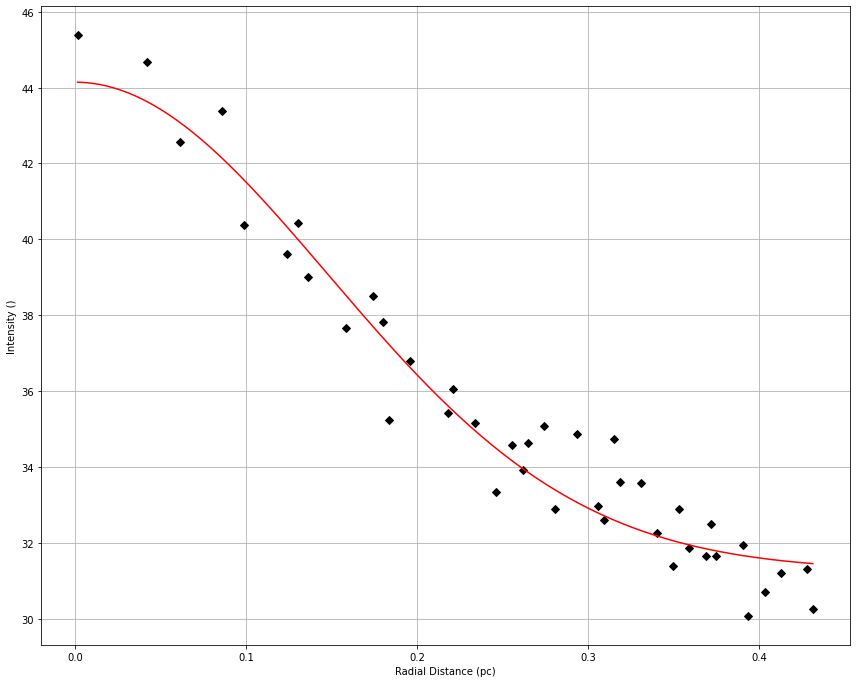

In [50]:
fil.filaments[0].plot_radial_profile(xunit=u.pc)

In [51]:
fil.total_intensity()

<Quantity [373039.06  ,  12835.768 ,  16836.652 , 271349.5   ,  11426.691 ,
           202376.89  ,   8941.591 ,   7507.1567,   6134.4023,   2175.733 ,
             8895.916 ,   7927.4995,   1678.1521]>

In [52]:
fil.output_table()

lengths,branches,total_intensity,median_brightness,orientation,curvature,X_posn,Y_posn,amplitude_0,amplitude_0_err,stddev_0,stddev_0_err,amplitude_1,amplitude_1_err,fwhm,fwhm_err,fail_flag,model_type
pix,,,,rad,rad,pix,pix,,,pix,pix,,,pix,pix,,
float64,int64,float32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,bool,str12
365.6046569018213,59,373039.06,45.378883361816406,1.0684808023909644,0.7538901651894063,86.0,76.0,12.874733513408355,0.5142349703974809,3.3916141902473025,0.1735052486150489,31.267431668422045,0.37618929895205827,7.514253106199593,0.4342588611648769,False,gaussian_bkg
35.600759900201815,3,12835.768,53.03895950317383,1.4663390288438591,0.7053298155166945,112.5,21.5,9.667589519606933,1.173369414335007,2.878965638212239,0.2493724207316196,45.586372863211935,0.2221203789874323,6.2159835893515805,0.6404577589213171,False,gaussian_bkg
36.21320343559643,3,16836.652,51.79900360107422,-1.5552058885563826,0.6705101901078461,152.0,19.0,51.58796783447266,2.0906565189361572,3.0753632984116255,10.0,40.68463821411133,9.071697235107422,6.7173709673808855,25.387067766158488,True,nonparam
502.27727543086536,57,271349.5,24.291215896606445,0.8816606454975908,0.9516952357730104,201.0,178.5,7.2015874815535765,0.5618128184813866,3.917555636947063,0.4502078686817881,15.397633038558821,0.5789981232973096,8.819339267096579,1.1089389882440885,False,gaussian_bkg
28.31370849898476,1,11426.691,87.81809997558594,-1.031615046732319,0.8150737277643207,250.0,23.5,87.87514343261718,6.251995086669922,2.1569377990430625,9.0,79.16659545898438,14.203954696655273,4.298353213562478,25.043410846726164,True,nonparam
297.9536861403704,26,202376.89,30.06881332397461,0.5459814611077798,0.7940289557359963,119.0,157.0,20.038467137410333,1.332229719491965,4.971597886797872,0.407871650412912,8.190886645080814,1.5737008879760948,11.390194279329936,0.9871970098255964,False,gaussian_bkg
32.21320343559643,3,8941.591,32.920562744140625,0.6088317104653655,0.5021761712311485,208.0,110.0,32.817487182617185,4.74882173538208,2.9206481096800996,9.899494936611665,17.906373596191404,5.364131927490234,6.322891393153143,25.35665714927981,True,nonparam
45.524973707767685,4,7507.1567,18.248733520507812,1.3306235684129808,0.8837370948008565,190.0,154.0,7.662722715274893,0.3040513201320447,4.527272435972219,0.3144232775048002,10.280751789130573,0.3617183996518916,10.311770272171257,0.7654794549431585,False,gaussian_bkg


In [53]:
import matplotlib.pyplot
import astropy.io.fits
import aplpy

# FITS ファイルを web からダウンロードする場合
fits = astropy.io.fits.open('https://cdsarc.cds.unistra.fr/ftp/J/A+A/594/A116/CUBES/GAL/TAN/TAN_F06.fits')
print(fits)

In [54]:
fig = aplpy.FITSFigure(fits[0:1])

# FITS ファイルが local に保存されている場合
# fig = aplpy.FITSFigure('Orion.CO1221.Osaka.beam204.mom0.fits.gz')

fig.show_colorscale()
fig.add_colorbar()
# fig.save('Orion.CO1221.Osaka.beam204.mom0.png')  # 画像を保存する場合

matplotlib.pyplot.show()


Exception: 
    Attempted to read in 3-dimensional FITS cube, but
    dimensions and slices were not specified. Please specify these
    using the dimensions= and slices= argument. The cube dimensions
    are:

           0 GLON-TAN 271
           1 GLAT-TAN 275
           2 VRAD 933
